# Afriat

In [1]:
scan=0.15

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: kwgxj3g4
Name: hokey-ewok-139
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/kwgxj3g4
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155911-kwgxj3g4/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2567,3271,9405
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2567,2556,1699,3419,1640,3362
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4514,10729
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 638,838,2334
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 638,646,409,871,409,837
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1070,2740
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:15<2:34:06, 15.44s/it]

Epoch 1/600:   0%|          | 1/600 [00:15<2:34:06, 15.44s/it, v_num=g4_1, total_loss_train=3.74e+3, kl_local_train=51.4]

Epoch 2/600:   0%|          | 1/600 [00:15<2:34:06, 15.44s/it, v_num=g4_1, total_loss_train=3.74e+3, kl_local_train=51.4]

Epoch 2/600:   0%|          | 2/600 [00:29<2:28:32, 14.90s/it, v_num=g4_1, total_loss_train=3.74e+3, kl_local_train=51.4]

Epoch 2/600:   0%|          | 2/600 [00:29<2:28:32, 14.90s/it, v_num=g4_1, total_loss_train=3.23e+3, kl_local_train=78.7]

Epoch 3/600:   0%|          | 2/600 [00:29<2:28:32, 14.90s/it, v_num=g4_1, total_loss_train=3.23e+3, kl_local_train=78.7]

Epoch 3/600:   0%|          | 3/600 [00:44<2:26:32, 14.73s/it, v_num=g4_1, total_loss_train=3.23e+3, kl_local_train=78.7]

Epoch 3/600:   0%|          | 3/600 [00:44<2:26:32, 14.73s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=81.1]

Epoch 4/600:   0%|          | 3/600 [00:44<2:26:32, 14.73s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=81.1]

Epoch 4/600:   1%|          | 4/600 [00:59<2:26:06, 14.71s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=81.1]

Epoch 4/600:   1%|          | 4/600 [00:59<2:26:06, 14.71s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 4/600 [00:59<2:26:06, 14.71s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 5/600 [01:13<2:25:58, 14.72s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=79.3]

Epoch 5/600:   1%|          | 5/600 [01:13<2:25:58, 14.72s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=74]  

Epoch 6/600:   1%|          | 5/600 [01:15<2:25:58, 14.72s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=74]

Epoch 6/600:   1%|          | 6/600 [01:29<2:27:36, 14.91s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=74]

Epoch 6/600:   1%|          | 6/600 [01:29<2:27:36, 14.91s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:29<2:27:36, 14.91s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:42<2:23:43, 14.54s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:42<2:23:43, 14.54s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:42<2:23:43, 14.54s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:56<2:20:07, 14.20s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=54.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:56<2:20:07, 14.20s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:56<2:20:07, 14.20s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:09<2:17:22, 13.95s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:09<2:17:22, 13.95s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [02:09<2:17:22, 13.95s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:23<2:15:37, 13.79s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:23<2:15:37, 13.79s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349] 

Epoch 11/600:   2%|▏         | 10/600 [02:24<2:15:37, 13.79s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:37<2:18:08, 14.07s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00746, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:37<2:18:08, 14.07s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 12/600:   2%|▏         | 11/600 [02:37<2:18:08, 14.07s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 12/600:   2%|▏         | 12/600 [02:51<2:15:29, 13.83s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 12/600:   2%|▏         | 12/600 [02:51<2:15:29, 13.83s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 13/600:   2%|▏         | 12/600 [02:51<2:15:29, 13.83s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 13/600:   2%|▏         | 13/600 [03:04<2:13:35, 13.66s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 13/600:   2%|▏         | 13/600 [03:04<2:13:35, 13.66s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 14/600:   2%|▏         | 13/600 [03:04<2:13:35, 13.66s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 14/600:   2%|▏         | 14/600 [03:17<2:12:11, 13.53s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 14/600:   2%|▏         | 14/600 [03:17<2:12:11, 13.53s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 15/600:   2%|▏         | 14/600 [03:17<2:12:11, 13.53s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 15/600:   2%|▎         | 15/600 [03:30<2:10:37, 13.40s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 15/600:   2%|▎         | 15/600 [03:30<2:10:37, 13.40s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=70.9, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 16/600:   2%|▎         | 15/600 [03:32<2:10:37, 13.40s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=70.9, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 16/600:   3%|▎         | 16/600 [03:45<2:14:33, 13.82s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=70.9, metric_mi|status_control_train=0.0317, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0507]

Epoch 16/600:   3%|▎         | 16/600 [03:45<2:14:33, 13.82s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 17/600:   3%|▎         | 16/600 [03:45<2:14:33, 13.82s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 17/600:   3%|▎         | 17/600 [03:58<2:12:16, 13.61s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 17/600:   3%|▎         | 17/600 [03:58<2:12:16, 13.61s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 18/600:   3%|▎         | 17/600 [03:58<2:12:16, 13.61s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 18/600:   3%|▎         | 18/600 [04:12<2:11:15, 13.53s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 18/600:   3%|▎         | 18/600 [04:12<2:11:15, 13.53s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 19/600:   3%|▎         | 18/600 [04:12<2:11:15, 13.53s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 19/600:   3%|▎         | 19/600 [04:25<2:10:24, 13.47s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 19/600:   3%|▎         | 19/600 [04:25<2:10:24, 13.47s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805] 

Epoch 20/600:   3%|▎         | 19/600 [04:25<2:10:24, 13.47s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 20/600:   3%|▎         | 20/600 [04:38<2:09:56, 13.44s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 20/600:   3%|▎         | 20/600 [04:38<2:09:56, 13.44s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 21/600:   3%|▎         | 20/600 [04:40<2:09:56, 13.44s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 21/600:   4%|▎         | 21/600 [04:53<2:13:05, 13.79s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0805]

Epoch 21/600:   4%|▎         | 21/600 [04:53<2:13:05, 13.79s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103] 

Epoch 22/600:   4%|▎         | 21/600 [04:53<2:13:05, 13.79s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [05:06<2:11:28, 13.65s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [05:06<2:11:28, 13.65s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▎         | 22/600 [05:06<2:11:28, 13.65s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [05:20<2:10:15, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [05:20<2:10:15, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 23/600 [05:20<2:10:15, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [05:33<2:09:21, 13.47s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [05:33<2:09:21, 13.47s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 24/600 [05:33<2:09:21, 13.47s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:46<2:08:57, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:46<2:08:57, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 25/600 [05:48<2:08:57, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [06:01<2:12:14, 13.82s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [06:01<2:12:14, 13.82s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111] 

Epoch 27/600:   4%|▍         | 26/600 [06:01<2:12:14, 13.82s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 27/600:   4%|▍         | 27/600 [06:14<2:10:20, 13.65s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 27/600:   4%|▍         | 27/600 [06:14<2:10:20, 13.65s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 28/600:   4%|▍         | 27/600 [06:14<2:10:20, 13.65s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 28/600:   5%|▍         | 28/600 [06:27<2:09:07, 13.54s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 28/600:   5%|▍         | 28/600 [06:27<2:09:07, 13.54s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|▍         | 28/600 [06:28<2:09:07, 13.54s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|▍         | 29/600 [06:41<2:08:05, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|▍         | 29/600 [06:41<2:08:05, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|▍         | 29/600 [06:41<2:08:05, 13.46s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|▌         | 30/600 [06:54<2:07:31, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|▌         | 30/600 [06:54<2:07:31, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|▌         | 30/600 [06:55<2:07:31, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|▌         | 31/600 [07:09<2:10:43, 13.79s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0726, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|▌         | 31/600 [07:09<2:10:43, 13.79s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]  

Epoch 32/600:   5%|▌         | 31/600 [07:09<2:10:43, 13.79s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [07:22<2:09:12, 13.65s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [07:22<2:09:12, 13.65s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 33/600:   5%|▌         | 32/600 [07:22<2:09:12, 13.65s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:35<2:08:01, 13.55s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:35<2:08:01, 13.55s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 33/600 [07:35<2:08:01, 13.55s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:49<2:07:22, 13.50s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:49<2:07:22, 13.50s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 34/600 [07:49<2:07:22, 13.50s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [08:02<2:06:53, 13.47s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [08:02<2:06:53, 13.47s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 35/600 [08:04<2:06:53, 13.47s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [08:17<2:10:02, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [08:17<2:10:02, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 37/600:   6%|▌         | 36/600 [08:17<2:10:02, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 37/600:   6%|▌         | 37/600 [08:30<2:08:32, 13.70s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 37/600:   6%|▌         | 37/600 [08:30<2:08:32, 13.70s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▌         | 37/600 [08:30<2:08:32, 13.70s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▋         | 38/600 [08:43<2:06:49, 13.54s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▋         | 38/600 [08:43<2:06:49, 13.54s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117] 

Epoch 39/600:   6%|▋         | 38/600 [08:43<2:06:49, 13.54s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 39/600:   6%|▋         | 39/600 [08:57<2:06:51, 13.57s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 39/600:   6%|▋         | 39/600 [08:57<2:06:51, 13.57s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 40/600:   6%|▋         | 39/600 [08:57<2:06:51, 13.57s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 40/600:   7%|▋         | 40/600 [09:09<2:02:28, 13.12s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 40/600:   7%|▋         | 40/600 [09:09<2:02:28, 13.12s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 40/600 [09:10<2:02:28, 13.12s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 41/600 [09:22<2:02:43, 13.17s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 41/600 [09:22<2:02:43, 13.17s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 41/600 [09:22<2:02:43, 13.17s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [09:34<1:59:02, 12.80s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [09:34<1:59:02, 12.80s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 42/600 [09:34<1:59:02, 12.80s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:46<1:56:56, 12.60s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:46<1:56:56, 12.60s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 43/600 [09:46<1:56:56, 12.60s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:59<1:55:17, 12.44s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:59<1:55:17, 12.44s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 45/600:   7%|▋         | 44/600 [09:59<1:55:17, 12.44s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [10:11<1:54:21, 12.36s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [10:11<1:54:21, 12.36s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 45/600 [10:12<1:54:21, 12.36s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [10:24<1:56:57, 12.67s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [10:24<1:56:57, 12.67s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124] 

Epoch 47/600:   8%|▊         | 46/600 [10:24<1:56:57, 12.67s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 47/600:   8%|▊         | 47/600 [10:36<1:55:01, 12.48s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 47/600:   8%|▊         | 47/600 [10:36<1:55:01, 12.48s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 47/600 [10:36<1:55:01, 12.48s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 48/600 [10:48<1:53:33, 12.34s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 48/600:   8%|▊         | 48/600 [10:48<1:53:33, 12.34s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 48/600 [10:48<1:53:33, 12.34s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 49/600 [11:00<1:52:31, 12.25s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 49/600:   8%|▊         | 49/600 [11:00<1:52:31, 12.25s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 49/600 [11:00<1:52:31, 12.25s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 50/600 [11:12<1:51:41, 12.19s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 50/600:   8%|▊         | 50/600 [11:12<1:51:41, 12.19s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 50/600 [11:14<1:51:41, 12.19s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 51/600 [11:26<1:54:51, 12.55s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=102, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 51/600:   8%|▊         | 51/600 [11:26<1:54:51, 12.55s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 52/600:   8%|▊         | 51/600 [11:26<1:54:51, 12.55s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [11:39<1:55:44, 12.67s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=101, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [11:39<1:55:44, 12.67s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=99.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▊         | 52/600 [11:39<1:55:44, 12.67s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=99.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:52<1:57:30, 12.89s/it, v_num=g4_1, total_loss_train=3.22e+3, kl_local_train=99.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:52<1:57:30, 12.89s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=99.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 53/600 [11:52<1:57:30, 12.89s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=99.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [12:05<1:58:30, 13.02s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=99.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [12:05<1:58:30, 13.02s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 54/600 [12:05<1:58:30, 13.02s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [12:19<1:59:06, 13.11s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [12:19<1:59:06, 13.11s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 55/600 [12:20<1:59:06, 13.11s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [12:33<2:03:02, 13.57s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [12:33<2:03:02, 13.57s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 57/600:   9%|▉         | 56/600 [12:33<2:03:02, 13.57s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 57/600:  10%|▉         | 57/600 [12:47<2:02:18, 13.51s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 57/600:  10%|▉         | 57/600 [12:47<2:02:18, 13.51s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 58/600:  10%|▉         | 57/600 [12:47<2:02:18, 13.51s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 58/600:  10%|▉         | 58/600 [13:00<2:01:35, 13.46s/it, v_num=g4_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 58/600:  10%|▉         | 58/600 [13:00<2:01:35, 13.46s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123] 

Epoch 59/600:  10%|▉         | 58/600 [13:00<2:01:35, 13.46s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 59/600:  10%|▉         | 59/600 [13:13<2:00:35, 13.38s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 59/600:  10%|▉         | 59/600 [13:13<2:00:35, 13.38s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 60/600:  10%|▉         | 59/600 [13:13<2:00:35, 13.38s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 60/600:  10%|█         | 60/600 [13:26<2:00:03, 13.34s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 60/600:  10%|█         | 60/600 [13:26<2:00:03, 13.34s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 61/600:  10%|█         | 60/600 [13:28<2:00:03, 13.34s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 61/600:  10%|█         | 61/600 [13:41<2:03:30, 13.75s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.123]

Epoch 61/600:  10%|█         | 61/600 [13:41<2:03:30, 13.75s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 61/600 [13:41<2:03:30, 13.75s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [13:54<2:02:12, 13.63s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [13:54<2:02:12, 13.63s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 62/600 [13:55<2:02:12, 13.63s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [14:08<2:01:07, 13.53s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=93.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [14:08<2:01:07, 13.53s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  10%|█         | 63/600 [14:08<2:01:07, 13.53s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [14:21<2:00:27, 13.48s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [14:21<2:00:27, 13.48s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 64/600 [14:21<2:00:27, 13.48s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [14:34<1:59:44, 13.43s/it, v_num=g4_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [14:34<1:59:44, 13.43s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 65/600 [14:36<1:59:44, 13.43s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [14:49<2:02:57, 13.82s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [14:49<2:02:57, 13.82s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12] 

Epoch 67/600:  11%|█         | 66/600 [14:49<2:02:57, 13.82s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [15:02<2:01:19, 13.66s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [15:02<2:01:19, 13.66s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█         | 67/600 [15:02<2:01:19, 13.66s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [15:16<2:00:16, 13.56s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [15:16<2:00:16, 13.56s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]  

Epoch 69/600:  11%|█▏        | 68/600 [15:16<2:00:16, 13.56s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [15:29<1:59:31, 13.51s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [15:29<1:59:31, 13.51s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 69/600 [15:29<1:59:31, 13.51s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [15:42<1:58:34, 13.42s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=87.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [15:42<1:58:34, 13.42s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 70/600 [15:44<1:58:34, 13.42s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:57<2:01:59, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:57<2:01:59, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|█▏        | 71/600 [15:57<2:01:59, 13.84s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|█▏        | 72/600 [16:10<2:00:01, 13.64s/it, v_num=g4_1, total_loss_train=3.19e+3, kl_local_train=86.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 72/600:  12%|█▏        | 72/600 [16:10<2:00:01, 13.64s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]  

Epoch 73/600:  12%|█▏        | 72/600 [16:10<2:00:01, 13.64s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 73/600:  12%|█▏        | 73/600 [16:24<1:59:25, 13.60s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 73/600:  12%|█▏        | 73/600 [16:24<1:59:25, 13.60s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|█▏        | 73/600 [16:24<1:59:25, 13.60s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|█▏        | 74/600 [16:37<1:58:52, 13.56s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 74/600:  12%|█▏        | 74/600 [16:37<1:58:52, 13.56s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|█▏        | 74/600 [16:37<1:58:52, 13.56s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|█▎        | 75/600 [16:51<1:58:15, 13.52s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 75/600:  12%|█▎        | 75/600 [16:51<1:58:15, 13.52s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 76/600:  12%|█▎        | 75/600 [16:52<1:58:15, 13.52s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 76/600:  13%|█▎        | 76/600 [17:05<2:01:06, 13.87s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.116]

Epoch 76/600:  13%|█▎        | 76/600 [17:05<2:01:06, 13.87s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 76/600 [17:05<2:01:06, 13.87s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 77/600 [17:19<1:59:24, 13.70s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 77/600 [17:19<1:59:24, 13.70s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 77/600 [17:19<1:59:24, 13.70s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 78/600 [17:32<1:58:02, 13.57s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 78/600 [17:32<1:58:02, 13.57s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 78/600 [17:32<1:58:02, 13.57s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 79/600 [17:45<1:56:33, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 79/600 [17:45<1:56:33, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 79/600 [17:45<1:56:33, 13.42s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 80/600 [17:58<1:56:07, 13.40s/it, v_num=g4_1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 80/600 [17:58<1:56:07, 13.40s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  13%|█▎        | 80/600 [18:00<1:56:07, 13.40s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  14%|█▎        | 81/600 [18:13<1:59:25, 13.81s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  14%|█▎        | 81/600 [18:13<1:59:25, 13.81s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 82/600:  14%|█▎        | 81/600 [18:13<1:59:25, 13.81s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 82/600:  14%|█▎        | 82/600 [18:27<1:58:22, 13.71s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 82/600:  14%|█▎        | 82/600 [18:27<1:58:22, 13.71s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▎        | 82/600 [18:27<1:58:22, 13.71s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▍        | 83/600 [18:40<1:57:28, 13.63s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▍        | 83/600 [18:40<1:57:28, 13.63s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 83/600 [18:40<1:57:28, 13.63s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 84/600 [18:54<1:56:52, 13.59s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 84/600 [18:54<1:56:52, 13.59s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 84/600 [18:54<1:56:52, 13.59s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 85/600 [19:07<1:56:14, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 85/600 [19:07<1:56:14, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]  

Epoch 86/600:  14%|█▍        | 85/600 [19:08<1:56:14, 13.54s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 86/600:  14%|█▍        | 86/600 [19:22<1:59:07, 13.91s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 86/600:  14%|█▍        | 86/600 [19:22<1:59:07, 13.91s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113] 

Epoch 87/600:  14%|█▍        | 86/600 [19:22<1:59:07, 13.91s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 87/600:  14%|█▍        | 87/600 [19:35<1:57:26, 13.74s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 87/600:  14%|█▍        | 87/600 [19:35<1:57:26, 13.74s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 88/600:  14%|█▍        | 87/600 [19:35<1:57:26, 13.74s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 88/600:  15%|█▍        | 88/600 [19:48<1:55:45, 13.57s/it, v_num=g4_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 88/600:  15%|█▍        | 88/600 [19:48<1:55:45, 13.57s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 89/600:  15%|█▍        | 88/600 [19:48<1:55:45, 13.57s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 89/600:  15%|█▍        | 89/600 [20:02<1:55:14, 13.53s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 89/600:  15%|█▍        | 89/600 [20:02<1:55:14, 13.53s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]  

Epoch 90/600:  15%|█▍        | 89/600 [20:02<1:55:14, 13.53s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 90/600:  15%|█▌        | 90/600 [20:15<1:54:27, 13.47s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 90/600:  15%|█▌        | 90/600 [20:15<1:54:27, 13.47s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 90/600 [20:16<1:54:27, 13.47s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 91/600 [20:30<1:57:14, 13.82s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 91/600 [20:30<1:57:14, 13.82s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 91/600 [20:30<1:57:14, 13.82s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 92/600 [20:43<1:55:41, 13.67s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|█▌        | 92/600 [20:43<1:55:41, 13.67s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  15%|█▌        | 92/600 [20:43<1:55:41, 13.67s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|█▌        | 93/600 [20:56<1:54:28, 13.55s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|█▌        | 93/600 [20:56<1:54:28, 13.55s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 93/600 [20:56<1:54:28, 13.55s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 94/600 [21:10<1:53:31, 13.46s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|█▌        | 94/600 [21:10<1:53:31, 13.46s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 94/600 [21:10<1:53:31, 13.46s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 95/600 [21:23<1:52:39, 13.39s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|█▌        | 95/600 [21:23<1:52:39, 13.39s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 95/600 [21:24<1:52:39, 13.39s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 96/600 [21:37<1:55:27, 13.75s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|█▌        | 96/600 [21:37<1:55:27, 13.75s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 96/600 [21:37<1:55:27, 13.75s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [21:50<1:53:35, 13.55s/it, v_num=g4_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [21:50<1:53:35, 13.55s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]  

Epoch 98/600:  16%|█▌        | 97/600 [21:51<1:53:35, 13.55s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [22:04<1:52:52, 13.49s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [22:04<1:52:52, 13.49s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 98/600 [22:04<1:52:52, 13.49s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [22:17<1:52:15, 13.44s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [22:17<1:52:15, 13.44s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  16%|█▋        | 99/600 [22:17<1:52:15, 13.44s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [22:30<1:51:35, 13.39s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [22:30<1:51:35, 13.39s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 100/600 [22:32<1:51:35, 13.39s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [22:45<1:54:34, 13.78s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [22:45<1:54:34, 13.78s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]  

Epoch 102/600:  17%|█▋        | 101/600 [22:45<1:54:34, 13.78s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:58<1:53:19, 13.65s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:58<1:53:19, 13.65s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [22:58<1:53:19, 13.65s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [23:12<1:52:22, 13.57s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [23:12<1:52:22, 13.57s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [23:12<1:52:22, 13.57s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [23:25<1:51:43, 13.51s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [23:25<1:51:43, 13.51s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [23:25<1:51:43, 13.51s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [23:39<1:51:37, 13.53s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [23:39<1:51:37, 13.53s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 105/600 [23:40<1:51:37, 13.53s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [23:53<1:53:36, 13.80s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [23:53<1:53:36, 13.80s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 106/600 [23:53<1:53:36, 13.80s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:07<1:52:31, 13.69s/it, v_num=g4_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:07<1:52:31, 13.69s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 107/600 [24:07<1:52:31, 13.69s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [24:20<1:51:43, 13.63s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [24:20<1:51:43, 13.63s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 108/600 [24:20<1:51:43, 13.63s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [24:34<1:51:12, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [24:34<1:51:12, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 109/600 [24:34<1:51:12, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [24:47<1:50:54, 13.58s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [24:47<1:50:54, 13.58s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 110/600 [24:49<1:50:54, 13.58s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [25:02<1:53:20, 13.91s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [25:02<1:53:20, 13.91s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  18%|█▊        | 111/600 [25:02<1:53:20, 13.91s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [25:15<1:51:33, 13.72s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [25:15<1:51:33, 13.72s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▊        | 112/600 [25:15<1:51:33, 13.72s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [25:28<1:50:19, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [25:28<1:50:19, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 113/600 [25:28<1:50:19, 13.59s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [25:42<1:49:45, 13.55s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [25:42<1:49:45, 13.55s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 114/600 [25:42<1:49:45, 13.55s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [25:55<1:49:26, 13.54s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [25:55<1:49:26, 13.54s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 115/600 [25:57<1:49:26, 13.54s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [26:10<1:52:15, 13.92s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [26:10<1:52:15, 13.92s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104] 

Epoch 117/600:  19%|█▉        | 116/600 [26:10<1:52:15, 13.92s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:24<1:50:52, 13.77s/it, v_num=g4_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:24<1:50:52, 13.77s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 117/600 [26:24<1:50:52, 13.77s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [26:37<1:49:47, 13.67s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [26:37<1:49:47, 13.67s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 118/600 [26:37<1:49:47, 13.67s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [26:50<1:48:17, 13.51s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [26:50<1:48:17, 13.51s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|█▉        | 119/600 [26:50<1:48:17, 13.51s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [27:04<1:48:00, 13.50s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [27:04<1:48:00, 13.50s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 120/600 [27:05<1:48:00, 13.50s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [27:18<1:50:50, 13.88s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [27:18<1:50:50, 13.88s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 121/600 [27:18<1:50:50, 13.88s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [27:32<1:49:29, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [27:32<1:49:29, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 122/600 [27:32<1:49:29, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [27:45<1:48:28, 13.64s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [27:45<1:48:28, 13.64s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 124/600:  20%|██        | 123/600 [27:45<1:48:28, 13.64s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [27:59<1:47:34, 13.56s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [27:59<1:47:34, 13.56s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 124/600 [27:59<1:47:34, 13.56s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [28:12<1:47:16, 13.55s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [28:12<1:47:16, 13.55s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 125/600 [28:14<1:47:16, 13.55s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [28:27<1:49:49, 13.90s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [28:27<1:49:49, 13.90s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102] 

Epoch 127/600:  21%|██        | 126/600 [28:27<1:49:49, 13.90s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 127/600:  21%|██        | 127/600 [28:40<1:48:19, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 127/600:  21%|██        | 127/600 [28:40<1:48:19, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██        | 127/600 [28:40<1:48:19, 13.74s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██▏       | 128/600 [28:53<1:46:32, 13.54s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 128/600:  21%|██▏       | 128/600 [28:53<1:46:32, 13.54s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 129/600:  21%|██▏       | 128/600 [28:53<1:46:32, 13.54s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 129/600:  22%|██▏       | 129/600 [29:07<1:45:57, 13.50s/it, v_num=g4_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 129/600:  22%|██▏       | 129/600 [29:07<1:45:57, 13.50s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 129/600 [29:07<1:45:57, 13.50s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 130/600 [29:20<1:45:50, 13.51s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 130/600:  22%|██▏       | 130/600 [29:20<1:45:50, 13.51s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 130/600 [29:22<1:45:50, 13.51s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 131/600 [29:35<1:48:31, 13.88s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 131/600:  22%|██▏       | 131/600 [29:35<1:48:31, 13.88s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 132/600:  22%|██▏       | 131/600 [29:35<1:48:31, 13.88s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 132/600:  22%|██▏       | 132/600 [29:48<1:47:14, 13.75s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 132/600:  22%|██▏       | 132/600 [29:48<1:47:14, 13.75s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 132/600 [29:49<1:47:14, 13.75s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 133/600 [30:02<1:46:09, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 133/600 [30:02<1:46:09, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 133/600 [30:02<1:46:09, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 134/600 [30:15<1:45:46, 13.62s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 134/600 [30:15<1:45:46, 13.62s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▏       | 134/600 [30:15<1:45:46, 13.62s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▎       | 135/600 [30:29<1:45:01, 13.55s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▎       | 135/600 [30:29<1:45:01, 13.55s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 136/600:  22%|██▎       | 135/600 [30:30<1:45:01, 13.55s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 136/600:  23%|██▎       | 136/600 [30:44<1:47:30, 13.90s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 136/600:  23%|██▎       | 136/600 [30:44<1:47:30, 13.90s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 137/600:  23%|██▎       | 136/600 [30:44<1:47:30, 13.90s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 137/600:  23%|██▎       | 137/600 [30:57<1:46:00, 13.74s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 137/600:  23%|██▎       | 137/600 [30:57<1:46:00, 13.74s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]  

Epoch 138/600:  23%|██▎       | 137/600 [30:57<1:46:00, 13.74s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 138/600:  23%|██▎       | 138/600 [31:10<1:44:59, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 138/600:  23%|██▎       | 138/600 [31:10<1:44:59, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 139/600:  23%|██▎       | 138/600 [31:10<1:44:59, 13.64s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 139/600:  23%|██▎       | 139/600 [31:24<1:43:57, 13.53s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 139/600:  23%|██▎       | 139/600 [31:24<1:43:57, 13.53s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 140/600:  23%|██▎       | 139/600 [31:24<1:43:57, 13.53s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 140/600:  23%|██▎       | 140/600 [31:37<1:42:50, 13.41s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 140/600:  23%|██▎       | 140/600 [31:37<1:42:50, 13.41s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 141/600:  23%|██▎       | 140/600 [31:38<1:42:50, 13.41s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 141/600:  24%|██▎       | 141/600 [31:51<1:45:36, 13.80s/it, v_num=g4_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.0999]

Epoch 141/600:  24%|██▎       | 141/600 [31:51<1:45:36, 13.80s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 142/600:  24%|██▎       | 141/600 [31:51<1:45:36, 13.80s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 142/600:  24%|██▎       | 142/600 [32:05<1:44:28, 13.69s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 142/600:  24%|██▎       | 142/600 [32:05<1:44:28, 13.69s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 143/600:  24%|██▎       | 142/600 [32:05<1:44:28, 13.69s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 143/600:  24%|██▍       | 143/600 [32:18<1:42:54, 13.51s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 143/600:  24%|██▍       | 143/600 [32:18<1:42:54, 13.51s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 144/600:  24%|██▍       | 143/600 [32:18<1:42:54, 13.51s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 144/600:  24%|██▍       | 144/600 [32:31<1:41:06, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 144/600:  24%|██▍       | 144/600 [32:31<1:41:06, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 145/600:  24%|██▍       | 144/600 [32:31<1:41:06, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 145/600:  24%|██▍       | 145/600 [32:44<1:40:05, 13.20s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 145/600:  24%|██▍       | 145/600 [32:44<1:40:05, 13.20s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 146/600:  24%|██▍       | 145/600 [32:45<1:40:05, 13.20s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 146/600:  24%|██▍       | 146/600 [32:58<1:41:58, 13.48s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0999]

Epoch 146/600:  24%|██▍       | 146/600 [32:58<1:41:58, 13.48s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 146/600 [32:58<1:41:58, 13.48s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [33:11<1:40:17, 13.28s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [33:11<1:40:17, 13.28s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 148/600:  24%|██▍       | 147/600 [33:11<1:40:17, 13.28s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [33:24<1:39:03, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [33:24<1:39:03, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]  

Epoch 149/600:  25%|██▍       | 148/600 [33:24<1:39:03, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [33:36<1:37:32, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [33:36<1:37:32, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▍       | 149/600 [33:36<1:37:32, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [33:49<1:37:20, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [33:49<1:37:20, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 150/600 [33:51<1:37:20, 12.98s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [34:03<1:39:31, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [34:03<1:39:31, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 152/600:  25%|██▌       | 151/600 [34:03<1:39:31, 13.30s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 152/600:  25%|██▌       | 152/600 [34:16<1:38:11, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 152/600:  25%|██▌       | 152/600 [34:16<1:38:11, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 153/600:  25%|██▌       | 152/600 [34:16<1:38:11, 13.15s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 153/600:  26%|██▌       | 153/600 [34:29<1:37:13, 13.05s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 153/600:  26%|██▌       | 153/600 [34:29<1:37:13, 13.05s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 154/600:  26%|██▌       | 153/600 [34:29<1:37:13, 13.05s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 154/600:  26%|██▌       | 154/600 [34:42<1:36:23, 12.97s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 154/600:  26%|██▌       | 154/600 [34:42<1:36:23, 12.97s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]  

Epoch 155/600:  26%|██▌       | 154/600 [34:42<1:36:23, 12.97s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 155/600:  26%|██▌       | 155/600 [34:54<1:36:06, 12.96s/it, v_num=g4_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 155/600:  26%|██▌       | 155/600 [34:54<1:36:06, 12.96s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 156/600:  26%|██▌       | 155/600 [34:56<1:36:06, 12.96s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 156/600:  26%|██▌       | 156/600 [35:09<1:38:22, 13.29s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0987]

Epoch 156/600:  26%|██▌       | 156/600 [35:09<1:38:22, 13.29s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971] 

Epoch 157/600:  26%|██▌       | 156/600 [35:09<1:38:22, 13.29s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 157/600:  26%|██▌       | 157/600 [35:21<1:37:13, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 157/600:  26%|██▌       | 157/600 [35:21<1:37:13, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 158/600:  26%|██▌       | 157/600 [35:21<1:37:13, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 158/600:  26%|██▋       | 158/600 [35:35<1:37:00, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 158/600:  26%|██▋       | 158/600 [35:35<1:37:00, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 159/600:  26%|██▋       | 158/600 [35:35<1:37:00, 13.17s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 159/600:  26%|██▋       | 159/600 [35:48<1:36:18, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 159/600:  26%|██▋       | 159/600 [35:48<1:36:18, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 160/600:  26%|██▋       | 159/600 [35:48<1:36:18, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 160/600:  27%|██▋       | 160/600 [36:01<1:36:04, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 160/600:  27%|██▋       | 160/600 [36:01<1:36:04, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 161/600:  27%|██▋       | 160/600 [36:02<1:36:04, 13.10s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 161/600:  27%|██▋       | 161/600 [36:15<1:38:22, 13.45s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0971]

Epoch 161/600:  27%|██▋       | 161/600 [36:15<1:38:22, 13.45s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 162/600:  27%|██▋       | 161/600 [36:15<1:38:22, 13.45s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 162/600:  27%|██▋       | 162/600 [36:28<1:36:48, 13.26s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 162/600:  27%|██▋       | 162/600 [36:28<1:36:48, 13.26s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 163/600:  27%|██▋       | 162/600 [36:28<1:36:48, 13.26s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 163/600:  27%|██▋       | 163/600 [36:41<1:35:38, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 163/600:  27%|██▋       | 163/600 [36:41<1:35:38, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 164/600:  27%|██▋       | 163/600 [36:41<1:35:38, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 164/600:  27%|██▋       | 164/600 [36:53<1:34:42, 13.03s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 164/600:  27%|██▋       | 164/600 [36:53<1:34:42, 13.03s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 165/600:  27%|██▋       | 164/600 [36:53<1:34:42, 13.03s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 165/600:  28%|██▊       | 165/600 [37:06<1:34:25, 13.02s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 165/600:  28%|██▊       | 165/600 [37:06<1:34:25, 13.02s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 166/600:  28%|██▊       | 165/600 [37:08<1:34:25, 13.02s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 166/600:  28%|██▊       | 166/600 [37:21<1:37:03, 13.42s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0893, metric_mi|mouse_train=0.095]

Epoch 166/600:  28%|██▊       | 166/600 [37:21<1:37:03, 13.42s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935] 

Epoch 167/600:  28%|██▊       | 166/600 [37:21<1:37:03, 13.42s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 167/600:  28%|██▊       | 167/600 [37:34<1:35:57, 13.30s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 167/600:  28%|██▊       | 167/600 [37:34<1:35:57, 13.30s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 168/600:  28%|██▊       | 167/600 [37:34<1:35:57, 13.30s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 168/600:  28%|██▊       | 168/600 [37:47<1:34:58, 13.19s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 168/600:  28%|██▊       | 168/600 [37:47<1:34:58, 13.19s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 169/600:  28%|██▊       | 168/600 [37:47<1:34:58, 13.19s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 169/600:  28%|██▊       | 169/600 [38:00<1:34:20, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 169/600:  28%|██▊       | 169/600 [38:00<1:34:20, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 170/600:  28%|██▊       | 169/600 [38:00<1:34:20, 13.13s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 170/600:  28%|██▊       | 170/600 [38:13<1:33:57, 13.11s/it, v_num=g4_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 170/600:  28%|██▊       | 170/600 [38:13<1:33:57, 13.11s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 171/600:  28%|██▊       | 170/600 [38:14<1:33:57, 13.11s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 171/600:  28%|██▊       | 171/600 [38:27<1:36:19, 13.47s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0935]

Epoch 171/600:  28%|██▊       | 171/600 [38:27<1:36:19, 13.47s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 172/600:  28%|██▊       | 171/600 [38:27<1:36:19, 13.47s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 172/600:  29%|██▊       | 172/600 [38:40<1:34:57, 13.31s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 172/600:  29%|██▊       | 172/600 [38:40<1:34:57, 13.31s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 173/600:  29%|██▊       | 172/600 [38:40<1:34:57, 13.31s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 173/600:  29%|██▉       | 173/600 [38:53<1:34:12, 13.24s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 173/600:  29%|██▉       | 173/600 [38:53<1:34:12, 13.24s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 174/600:  29%|██▉       | 173/600 [38:53<1:34:12, 13.24s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 174/600:  29%|██▉       | 174/600 [39:06<1:33:00, 13.10s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 174/600:  29%|██▉       | 174/600 [39:06<1:33:00, 13.10s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]  

Epoch 175/600:  29%|██▉       | 174/600 [39:06<1:33:00, 13.10s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 175/600:  29%|██▉       | 175/600 [39:19<1:32:54, 13.12s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 175/600:  29%|██▉       | 175/600 [39:19<1:32:54, 13.12s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 176/600:  29%|██▉       | 175/600 [39:20<1:32:54, 13.12s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 176/600:  29%|██▉       | 176/600 [39:33<1:35:08, 13.46s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0929]

Epoch 176/600:  29%|██▉       | 176/600 [39:33<1:35:08, 13.46s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 177/600:  29%|██▉       | 176/600 [39:33<1:35:08, 13.46s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 177/600:  30%|██▉       | 177/600 [39:46<1:33:57, 13.33s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 177/600:  30%|██▉       | 177/600 [39:46<1:33:57, 13.33s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 178/600:  30%|██▉       | 177/600 [39:46<1:33:57, 13.33s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 178/600:  30%|██▉       | 178/600 [39:59<1:32:58, 13.22s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 178/600:  30%|██▉       | 178/600 [39:59<1:32:58, 13.22s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 179/600:  30%|██▉       | 178/600 [39:59<1:32:58, 13.22s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 179/600:  30%|██▉       | 179/600 [40:12<1:32:13, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 179/600:  30%|██▉       | 179/600 [40:12<1:32:13, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 180/600:  30%|██▉       | 179/600 [40:12<1:32:13, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 180/600:  30%|███       | 180/600 [40:25<1:31:57, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 180/600:  30%|███       | 180/600 [40:25<1:31:57, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 181/600:  30%|███       | 180/600 [40:27<1:31:57, 13.14s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 181/600:  30%|███       | 181/600 [40:40<1:34:23, 13.52s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0927]

Epoch 181/600:  30%|███       | 181/600 [40:40<1:34:23, 13.52s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 182/600:  30%|███       | 181/600 [40:40<1:34:23, 13.52s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 182/600:  30%|███       | 182/600 [40:53<1:32:57, 13.34s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 182/600:  30%|███       | 182/600 [40:53<1:32:57, 13.34s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 183/600:  30%|███       | 182/600 [40:53<1:32:57, 13.34s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 183/600:  30%|███       | 183/600 [41:06<1:32:04, 13.25s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 183/600:  30%|███       | 183/600 [41:06<1:32:04, 13.25s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 184/600:  30%|███       | 183/600 [41:06<1:32:04, 13.25s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 184/600:  31%|███       | 184/600 [41:18<1:30:35, 13.07s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 184/600:  31%|███       | 184/600 [41:18<1:30:35, 13.07s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 185/600:  31%|███       | 184/600 [41:18<1:30:35, 13.07s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 185/600:  31%|███       | 185/600 [41:30<1:28:28, 12.79s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 185/600:  31%|███       | 185/600 [41:30<1:28:28, 12.79s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 186/600:  31%|███       | 185/600 [41:32<1:28:28, 12.79s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 186/600:  31%|███       | 186/600 [41:44<1:29:24, 12.96s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.093]

Epoch 186/600:  31%|███       | 186/600 [41:44<1:29:24, 12.96s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 187/600:  31%|███       | 186/600 [41:44<1:29:24, 12.96s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 187/600:  31%|███       | 187/600 [41:56<1:26:57, 12.63s/it, v_num=g4_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 187/600:  31%|███       | 187/600 [41:56<1:26:57, 12.63s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 188/600:  31%|███       | 187/600 [41:56<1:26:57, 12.63s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 188/600:  31%|███▏      | 188/600 [42:08<1:25:20, 12.43s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 188/600:  31%|███▏      | 188/600 [42:08<1:25:20, 12.43s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 189/600:  31%|███▏      | 188/600 [42:08<1:25:20, 12.43s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 189/600:  32%|███▏      | 189/600 [42:20<1:24:08, 12.28s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 189/600:  32%|███▏      | 189/600 [42:20<1:24:08, 12.28s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 190/600:  32%|███▏      | 189/600 [42:20<1:24:08, 12.28s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 190/600:  32%|███▏      | 190/600 [42:32<1:23:29, 12.22s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 190/600:  32%|███▏      | 190/600 [42:32<1:23:29, 12.22s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 191/600:  32%|███▏      | 190/600 [42:33<1:23:29, 12.22s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 191/600:  32%|███▏      | 191/600 [42:45<1:25:18, 12.51s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0969, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0937]

Epoch 191/600:  32%|███▏      | 191/600 [42:45<1:25:18, 12.51s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 192/600:  32%|███▏      | 191/600 [42:45<1:25:18, 12.51s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 192/600:  32%|███▏      | 192/600 [42:57<1:23:47, 12.32s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 192/600:  32%|███▏      | 192/600 [42:57<1:23:47, 12.32s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 193/600:  32%|███▏      | 192/600 [42:57<1:23:47, 12.32s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 193/600:  32%|███▏      | 193/600 [43:09<1:23:11, 12.26s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 193/600:  32%|███▏      | 193/600 [43:09<1:23:11, 12.26s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 194/600:  32%|███▏      | 193/600 [43:09<1:23:11, 12.26s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 194/600:  32%|███▏      | 194/600 [43:22<1:24:35, 12.50s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 194/600:  32%|███▏      | 194/600 [43:22<1:24:35, 12.50s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 195/600:  32%|███▏      | 194/600 [43:22<1:24:35, 12.50s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 195/600:  32%|███▎      | 195/600 [43:35<1:25:47, 12.71s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 195/600:  32%|███▎      | 195/600 [43:35<1:25:47, 12.71s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 196/600:  32%|███▎      | 195/600 [43:36<1:25:47, 12.71s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 196/600:  33%|███▎      | 196/600 [43:49<1:28:53, 13.20s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 196/600:  33%|███▎      | 196/600 [43:49<1:28:53, 13.20s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 197/600:  33%|███▎      | 196/600 [43:49<1:28:53, 13.20s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 197/600:  33%|███▎      | 197/600 [44:02<1:28:16, 13.14s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 197/600:  33%|███▎      | 197/600 [44:02<1:28:16, 13.14s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 198/600:  33%|███▎      | 197/600 [44:02<1:28:16, 13.14s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 198/600:  33%|███▎      | 198/600 [44:15<1:27:37, 13.08s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 198/600:  33%|███▎      | 198/600 [44:15<1:27:37, 13.08s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 199/600:  33%|███▎      | 198/600 [44:15<1:27:37, 13.08s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 199/600:  33%|███▎      | 199/600 [44:29<1:27:31, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 199/600:  33%|███▎      | 199/600 [44:29<1:27:31, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 200/600:  33%|███▎      | 199/600 [44:29<1:27:31, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 200/600:  33%|███▎      | 200/600 [44:42<1:27:18, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 200/600:  33%|███▎      | 200/600 [44:42<1:27:18, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 201/600:  33%|███▎      | 200/600 [44:43<1:27:18, 13.10s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 201/600:  34%|███▎      | 201/600 [44:56<1:30:22, 13.59s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0935]

Epoch 201/600:  34%|███▎      | 201/600 [44:56<1:30:22, 13.59s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924] 

Epoch 202/600:  34%|███▎      | 201/600 [44:56<1:30:22, 13.59s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 202/600:  34%|███▎      | 202/600 [45:09<1:29:02, 13.42s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 202/600:  34%|███▎      | 202/600 [45:09<1:29:02, 13.42s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 203/600:  34%|███▎      | 202/600 [45:09<1:29:02, 13.42s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 203/600:  34%|███▍      | 203/600 [45:22<1:27:55, 13.29s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 203/600:  34%|███▍      | 203/600 [45:22<1:27:55, 13.29s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 204/600:  34%|███▍      | 203/600 [45:22<1:27:55, 13.29s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 204/600:  34%|███▍      | 204/600 [45:35<1:26:54, 13.17s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 204/600:  34%|███▍      | 204/600 [45:35<1:26:54, 13.17s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 205/600:  34%|███▍      | 204/600 [45:35<1:26:54, 13.17s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 205/600:  34%|███▍      | 205/600 [45:48<1:26:45, 13.18s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 205/600:  34%|███▍      | 205/600 [45:48<1:26:45, 13.18s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 206/600:  34%|███▍      | 205/600 [45:50<1:26:45, 13.18s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 206/600:  34%|███▍      | 206/600 [46:03<1:28:35, 13.49s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 206/600:  34%|███▍      | 206/600 [46:03<1:28:35, 13.49s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 207/600:  34%|███▍      | 206/600 [46:03<1:28:35, 13.49s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 207/600:  34%|███▍      | 207/600 [46:15<1:26:55, 13.27s/it, v_num=g4_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 207/600:  34%|███▍      | 207/600 [46:15<1:26:55, 13.27s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 208/600:  34%|███▍      | 207/600 [46:15<1:26:55, 13.27s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 208/600:  35%|███▍      | 208/600 [46:28<1:26:03, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 208/600:  35%|███▍      | 208/600 [46:28<1:26:03, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 209/600:  35%|███▍      | 208/600 [46:28<1:26:03, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 209/600:  35%|███▍      | 209/600 [46:41<1:25:25, 13.11s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 209/600:  35%|███▍      | 209/600 [46:41<1:25:25, 13.11s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 210/600:  35%|███▍      | 209/600 [46:41<1:25:25, 13.11s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 210/600:  35%|███▌      | 210/600 [46:55<1:25:28, 13.15s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 210/600:  35%|███▌      | 210/600 [46:55<1:25:28, 13.15s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 211/600:  35%|███▌      | 210/600 [46:56<1:25:28, 13.15s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 211/600:  35%|███▌      | 211/600 [47:09<1:27:24, 13.48s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0912]

Epoch 211/600:  35%|███▌      | 211/600 [47:09<1:27:24, 13.48s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 212/600:  35%|███▌      | 211/600 [47:09<1:27:24, 13.48s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 212/600:  35%|███▌      | 212/600 [47:22<1:26:03, 13.31s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 212/600:  35%|███▌      | 212/600 [47:22<1:26:03, 13.31s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 213/600:  35%|███▌      | 212/600 [47:22<1:26:03, 13.31s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 213/600:  36%|███▌      | 213/600 [47:35<1:24:55, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 213/600:  36%|███▌      | 213/600 [47:35<1:24:55, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 214/600:  36%|███▌      | 213/600 [47:35<1:24:55, 13.17s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 214/600:  36%|███▌      | 214/600 [47:47<1:24:12, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 214/600:  36%|███▌      | 214/600 [47:47<1:24:12, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 215/600:  36%|███▌      | 214/600 [47:47<1:24:12, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 215/600:  36%|███▌      | 215/600 [48:01<1:24:25, 13.16s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 215/600:  36%|███▌      | 215/600 [48:01<1:24:25, 13.16s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 216/600:  36%|███▌      | 215/600 [48:02<1:24:25, 13.16s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 216/600:  36%|███▌      | 216/600 [48:15<1:26:22, 13.50s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0889]

Epoch 216/600:  36%|███▌      | 216/600 [48:15<1:26:22, 13.50s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 217/600:  36%|███▌      | 216/600 [48:15<1:26:22, 13.50s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 217/600:  36%|███▌      | 217/600 [48:28<1:25:06, 13.33s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 217/600:  36%|███▌      | 217/600 [48:28<1:25:06, 13.33s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 218/600:  36%|███▌      | 217/600 [48:28<1:25:06, 13.33s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 218/600:  36%|███▋      | 218/600 [48:41<1:24:03, 13.20s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 218/600:  36%|███▋      | 218/600 [48:41<1:24:03, 13.20s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 219/600:  36%|███▋      | 218/600 [48:41<1:24:03, 13.20s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 219/600:  36%|███▋      | 219/600 [48:54<1:23:08, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 219/600:  36%|███▋      | 219/600 [48:54<1:23:08, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 220/600:  36%|███▋      | 219/600 [48:54<1:23:08, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 220/600:  37%|███▋      | 220/600 [49:07<1:22:55, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 220/600:  37%|███▋      | 220/600 [49:07<1:22:55, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 221/600:  37%|███▋      | 220/600 [49:08<1:22:55, 13.09s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 221/600:  37%|███▋      | 221/600 [49:21<1:24:43, 13.41s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0897, metric_mi|time_cat_train=0.0774, metric_mi|mouse_train=0.0872]

Epoch 221/600:  37%|███▋      | 221/600 [49:21<1:24:43, 13.41s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 222/600:  37%|███▋      | 221/600 [49:21<1:24:43, 13.41s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 222/600:  37%|███▋      | 222/600 [49:34<1:23:20, 13.23s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 222/600:  37%|███▋      | 222/600 [49:34<1:23:20, 13.23s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]  

Epoch 223/600:  37%|███▋      | 222/600 [49:34<1:23:20, 13.23s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 223/600:  37%|███▋      | 223/600 [49:47<1:22:19, 13.10s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 223/600:  37%|███▋      | 223/600 [49:47<1:22:19, 13.10s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 224/600:  37%|███▋      | 223/600 [49:47<1:22:19, 13.10s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 224/600:  37%|███▋      | 224/600 [49:59<1:21:33, 13.01s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 224/600:  37%|███▋      | 224/600 [49:59<1:21:33, 13.01s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 225/600:  37%|███▋      | 224/600 [49:59<1:21:33, 13.01s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 225/600:  38%|███▊      | 225/600 [50:13<1:21:30, 13.04s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 225/600:  38%|███▊      | 225/600 [50:13<1:21:30, 13.04s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 226/600:  38%|███▊      | 225/600 [50:14<1:21:30, 13.04s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 226/600:  38%|███▊      | 226/600 [50:27<1:23:21, 13.37s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0861]

Epoch 226/600:  38%|███▊      | 226/600 [50:27<1:23:21, 13.37s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854] 

Epoch 227/600:  38%|███▊      | 226/600 [50:27<1:23:21, 13.37s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 227/600:  38%|███▊      | 227/600 [50:39<1:22:01, 13.19s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 227/600:  38%|███▊      | 227/600 [50:39<1:22:01, 13.19s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 228/600:  38%|███▊      | 227/600 [50:39<1:22:01, 13.19s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 228/600:  38%|███▊      | 228/600 [50:52<1:21:03, 13.07s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 228/600:  38%|███▊      | 228/600 [50:52<1:21:03, 13.07s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 229/600:  38%|███▊      | 228/600 [50:52<1:21:03, 13.07s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 229/600:  38%|███▊      | 229/600 [51:05<1:20:15, 12.98s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 229/600:  38%|███▊      | 229/600 [51:05<1:20:15, 12.98s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 230/600:  38%|███▊      | 229/600 [51:05<1:20:15, 12.98s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 230/600:  38%|███▊      | 230/600 [51:18<1:20:09, 13.00s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 230/600:  38%|███▊      | 230/600 [51:18<1:20:09, 13.00s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 231/600:  38%|███▊      | 230/600 [51:19<1:20:09, 13.00s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 231/600:  38%|███▊      | 231/600 [51:32<1:21:57, 13.33s/it, v_num=g4_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0854]

Epoch 231/600:  38%|███▊      | 231/600 [51:32<1:21:57, 13.33s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 232/600:  38%|███▊      | 231/600 [51:32<1:21:57, 13.33s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 232/600:  39%|███▊      | 232/600 [51:45<1:20:43, 13.16s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 232/600:  39%|███▊      | 232/600 [51:45<1:20:43, 13.16s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 233/600:  39%|███▊      | 232/600 [51:45<1:20:43, 13.16s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 233/600:  39%|███▉      | 233/600 [51:58<1:19:50, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 233/600:  39%|███▉      | 233/600 [51:58<1:19:50, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 234/600:  39%|███▉      | 233/600 [51:58<1:19:50, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 234/600:  39%|███▉      | 234/600 [52:11<1:19:07, 12.97s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 234/600:  39%|███▉      | 234/600 [52:11<1:19:07, 12.97s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 235/600:  39%|███▉      | 234/600 [52:11<1:19:07, 12.97s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 235/600:  39%|███▉      | 235/600 [52:23<1:18:10, 12.85s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 235/600:  39%|███▉      | 235/600 [52:23<1:18:10, 12.85s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 236/600:  39%|███▉      | 235/600 [52:25<1:18:10, 12.85s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 236/600:  39%|███▉      | 236/600 [52:37<1:20:20, 13.24s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0847]

Epoch 236/600:  39%|███▉      | 236/600 [52:37<1:20:20, 13.24s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 237/600:  39%|███▉      | 236/600 [52:37<1:20:20, 13.24s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 237/600:  40%|███▉      | 237/600 [52:50<1:19:20, 13.11s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 237/600:  40%|███▉      | 237/600 [52:50<1:19:20, 13.11s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 237/600 [52:50<1:19:20, 13.11s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 238/600 [53:03<1:18:44, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 238/600 [53:03<1:18:44, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]  

Epoch 239/600:  40%|███▉      | 238/600 [53:03<1:18:44, 13.05s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 239/600:  40%|███▉      | 239/600 [53:16<1:18:48, 13.10s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 239/600:  40%|███▉      | 239/600 [53:16<1:18:48, 13.10s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|███▉      | 239/600 [53:16<1:18:48, 13.10s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|████      | 240/600 [53:30<1:19:11, 13.20s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|████      | 240/600 [53:30<1:19:11, 13.20s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]  

Epoch 241/600:  40%|████      | 240/600 [53:31<1:19:11, 13.20s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 241/600:  40%|████      | 241/600 [53:44<1:21:23, 13.60s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0846]

Epoch 241/600:  40%|████      | 241/600 [53:44<1:21:23, 13.60s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 241/600 [53:44<1:21:23, 13.60s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [53:57<1:20:17, 13.46s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [53:57<1:20:17, 13.46s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 242/600 [53:57<1:20:17, 13.46s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [54:10<1:19:28, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [54:10<1:19:28, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 244/600:  40%|████      | 243/600 [54:10<1:19:28, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [54:24<1:18:57, 13.31s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [54:24<1:18:57, 13.31s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 244/600 [54:24<1:18:57, 13.31s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [54:37<1:19:01, 13.35s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [54:37<1:19:01, 13.35s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 245/600 [54:38<1:19:01, 13.35s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [54:52<1:20:59, 13.73s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [54:52<1:20:59, 13.73s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844] 

Epoch 247/600:  41%|████      | 246/600 [54:52<1:20:59, 13.73s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 247/600:  41%|████      | 247/600 [55:05<1:19:56, 13.59s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 247/600:  41%|████      | 247/600 [55:05<1:19:56, 13.59s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 248/600:  41%|████      | 247/600 [55:05<1:19:56, 13.59s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 248/600:  41%|████▏     | 248/600 [55:18<1:19:05, 13.48s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 248/600:  41%|████▏     | 248/600 [55:18<1:19:05, 13.48s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 249/600:  41%|████▏     | 248/600 [55:18<1:19:05, 13.48s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 249/600:  42%|████▏     | 249/600 [55:31<1:18:23, 13.40s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 249/600:  42%|████▏     | 249/600 [55:31<1:18:23, 13.40s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 250/600:  42%|████▏     | 249/600 [55:31<1:18:23, 13.40s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 250/600:  42%|████▏     | 250/600 [55:45<1:18:29, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 250/600:  42%|████▏     | 250/600 [55:45<1:18:29, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 251/600:  42%|████▏     | 250/600 [55:46<1:18:29, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 251/600:  42%|████▏     | 251/600 [56:00<1:20:29, 13.84s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0844]

Epoch 251/600:  42%|████▏     | 251/600 [56:00<1:20:29, 13.84s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 252/600:  42%|████▏     | 251/600 [56:00<1:20:29, 13.84s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 252/600:  42%|████▏     | 252/600 [56:13<1:19:11, 13.65s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 252/600:  42%|████▏     | 252/600 [56:13<1:19:11, 13.65s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 253/600:  42%|████▏     | 252/600 [56:13<1:19:11, 13.65s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 253/600:  42%|████▏     | 253/600 [56:26<1:18:14, 13.53s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 253/600:  42%|████▏     | 253/600 [56:26<1:18:14, 13.53s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 254/600:  42%|████▏     | 253/600 [56:26<1:18:14, 13.53s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 254/600:  42%|████▏     | 254/600 [56:39<1:17:25, 13.43s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 254/600:  42%|████▏     | 254/600 [56:39<1:17:25, 13.43s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 255/600:  42%|████▏     | 254/600 [56:39<1:17:25, 13.43s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 255/600:  42%|████▎     | 255/600 [56:53<1:17:08, 13.41s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 255/600:  42%|████▎     | 255/600 [56:53<1:17:08, 13.41s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 256/600:  42%|████▎     | 255/600 [56:54<1:17:08, 13.41s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 256/600:  43%|████▎     | 256/600 [57:07<1:18:48, 13.74s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0844]

Epoch 256/600:  43%|████▎     | 256/600 [57:07<1:18:48, 13.74s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 257/600:  43%|████▎     | 256/600 [57:07<1:18:48, 13.74s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 257/600:  43%|████▎     | 257/600 [57:20<1:17:18, 13.52s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 257/600:  43%|████▎     | 257/600 [57:20<1:17:18, 13.52s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 258/600:  43%|████▎     | 257/600 [57:20<1:17:18, 13.52s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 258/600:  43%|████▎     | 258/600 [57:34<1:16:41, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 258/600:  43%|████▎     | 258/600 [57:34<1:16:41, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 259/600:  43%|████▎     | 258/600 [57:34<1:16:41, 13.45s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 259/600:  43%|████▎     | 259/600 [57:47<1:15:48, 13.34s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 259/600:  43%|████▎     | 259/600 [57:47<1:15:48, 13.34s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 260/600:  43%|████▎     | 259/600 [57:47<1:15:48, 13.34s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 260/600:  43%|████▎     | 260/600 [58:00<1:15:43, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 260/600:  43%|████▎     | 260/600 [58:00<1:15:43, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 261/600:  43%|████▎     | 260/600 [58:02<1:15:43, 13.36s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 261/600:  44%|████▎     | 261/600 [58:15<1:17:26, 13.71s/it, v_num=g4_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0793, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0838]

Epoch 261/600:  44%|████▎     | 261/600 [58:15<1:17:26, 13.71s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 262/600:  44%|████▎     | 261/600 [58:15<1:17:26, 13.71s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 262/600:  44%|████▎     | 262/600 [58:28<1:16:20, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 262/600:  44%|████▎     | 262/600 [58:28<1:16:20, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 263/600:  44%|████▎     | 262/600 [58:28<1:16:20, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 263/600:  44%|████▍     | 263/600 [58:41<1:15:34, 13.46s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 263/600:  44%|████▍     | 263/600 [58:41<1:15:34, 13.46s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 264/600:  44%|████▍     | 263/600 [58:41<1:15:34, 13.46s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 264/600:  44%|████▍     | 264/600 [58:54<1:14:48, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 264/600:  44%|████▍     | 264/600 [58:54<1:14:48, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 265/600:  44%|████▍     | 264/600 [58:54<1:14:48, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 265/600:  44%|████▍     | 265/600 [59:07<1:14:37, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 265/600:  44%|████▍     | 265/600 [59:07<1:14:37, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 266/600:  44%|████▍     | 265/600 [59:09<1:14:37, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 266/600:  44%|████▍     | 266/600 [59:22<1:16:14, 13.70s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0715, metric_mi|mouse_train=0.0835]

Epoch 266/600:  44%|████▍     | 266/600 [59:22<1:16:14, 13.70s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]  

Epoch 267/600:  44%|████▍     | 266/600 [59:22<1:16:14, 13.70s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 267/600:  44%|████▍     | 267/600 [59:35<1:15:04, 13.53s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 267/600:  44%|████▍     | 267/600 [59:35<1:15:04, 13.53s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 268/600:  44%|████▍     | 267/600 [59:35<1:15:04, 13.53s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 268/600:  45%|████▍     | 268/600 [59:48<1:14:16, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 268/600:  45%|████▍     | 268/600 [59:48<1:14:16, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 269/600:  45%|████▍     | 268/600 [59:48<1:14:16, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 269/600:  45%|████▍     | 269/600 [1:00:01<1:13:36, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 269/600:  45%|████▍     | 269/600 [1:00:01<1:13:36, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 270/600:  45%|████▍     | 269/600 [1:00:01<1:13:36, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 270/600:  45%|████▌     | 270/600 [1:00:15<1:13:36, 13.38s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 270/600:  45%|████▌     | 270/600 [1:00:15<1:13:36, 13.38s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 271/600:  45%|████▌     | 270/600 [1:00:16<1:13:36, 13.38s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 271/600:  45%|████▌     | 271/600 [1:00:29<1:15:03, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0827]

Epoch 271/600:  45%|████▌     | 271/600 [1:00:29<1:15:03, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 272/600:  45%|████▌     | 271/600 [1:00:29<1:15:03, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:43<1:14:09, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:43<1:14:09, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 273/600:  45%|████▌     | 272/600 [1:00:43<1:14:09, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:56<1:13:24, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:56<1:13:24, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 274/600:  46%|████▌     | 273/600 [1:00:56<1:13:24, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 274/600:  46%|████▌     | 274/600 [1:01:09<1:12:44, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 274/600:  46%|████▌     | 274/600 [1:01:09<1:12:44, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 275/600:  46%|████▌     | 274/600 [1:01:09<1:12:44, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 275/600:  46%|████▌     | 275/600 [1:01:22<1:12:04, 13.31s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 275/600:  46%|████▌     | 275/600 [1:01:22<1:12:04, 13.31s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 276/600:  46%|████▌     | 275/600 [1:01:23<1:12:04, 13.31s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:37<1:13:47, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0819]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:37<1:13:47, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████▌     | 276/600 [1:01:37<1:13:47, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:50<1:12:42, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:50<1:12:42, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████▌     | 277/600 [1:01:50<1:12:42, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████▋     | 278/600 [1:02:03<1:11:52, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████▋     | 278/600 [1:02:03<1:11:52, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████▋     | 278/600 [1:02:03<1:11:52, 13.39s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████▋     | 279/600 [1:02:16<1:11:15, 13.32s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████▋     | 279/600 [1:02:16<1:11:15, 13.32s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 280/600:  46%|████▋     | 279/600 [1:02:16<1:11:15, 13.32s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 280/600:  47%|████▋     | 280/600 [1:02:29<1:11:08, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 280/600:  47%|████▋     | 280/600 [1:02:29<1:11:08, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|████▋     | 280/600 [1:02:31<1:11:08, 13.34s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:44<1:12:40, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0866, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:44<1:12:40, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]  

Epoch 282/600:  47%|████▋     | 281/600 [1:02:44<1:12:40, 13.67s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:57<1:11:36, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:57<1:11:36, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 283/600:  47%|████▋     | 282/600 [1:02:57<1:11:36, 13.51s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 283/600:  47%|████▋     | 283/600 [1:03:10<1:10:47, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 283/600:  47%|████▋     | 283/600 [1:03:10<1:10:47, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 284/600:  47%|████▋     | 283/600 [1:03:10<1:10:47, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 284/600:  47%|████▋     | 284/600 [1:03:23<1:10:19, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 284/600:  47%|████▋     | 284/600 [1:03:23<1:10:19, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]  

Epoch 285/600:  47%|████▋     | 284/600 [1:03:23<1:10:19, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:37<1:10:10, 13.37s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:37<1:10:10, 13.37s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 286/600:  48%|████▊     | 285/600 [1:03:38<1:10:10, 13.37s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:51<1:11:48, 13.72s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0794]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:51<1:11:48, 13.72s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 287/600:  48%|████▊     | 286/600 [1:03:51<1:11:48, 13.72s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 287/600:  48%|████▊     | 287/600 [1:04:04<1:10:40, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 287/600:  48%|████▊     | 287/600 [1:04:04<1:10:40, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 288/600:  48%|████▊     | 287/600 [1:04:04<1:10:40, 13.55s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 288/600:  48%|████▊     | 288/600 [1:04:18<1:09:46, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 288/600:  48%|████▊     | 288/600 [1:04:18<1:09:46, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 289/600:  48%|████▊     | 288/600 [1:04:18<1:09:46, 13.42s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 289/600:  48%|████▊     | 289/600 [1:04:31<1:09:04, 13.33s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 289/600:  48%|████▊     | 289/600 [1:04:31<1:09:04, 13.33s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 290/600:  48%|████▊     | 289/600 [1:04:31<1:09:04, 13.33s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:44<1:08:35, 13.28s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:44<1:08:35, 13.28s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 291/600:  48%|████▊     | 290/600 [1:04:45<1:08:35, 13.28s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:58<1:10:29, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0713, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0789]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:58<1:10:29, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 292/600:  48%|████▊     | 291/600 [1:04:58<1:10:29, 13.69s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 292/600:  49%|████▊     | 292/600 [1:05:12<1:09:38, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 292/600:  49%|████▊     | 292/600 [1:05:12<1:09:38, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▊     | 292/600 [1:05:12<1:09:38, 13.57s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▉     | 293/600 [1:05:25<1:08:55, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▉     | 293/600 [1:05:25<1:08:55, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 293/600 [1:05:25<1:08:55, 13.47s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:38<1:08:21, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:38<1:08:21, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 294/600 [1:05:38<1:08:21, 13.40s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:52<1:08:09, 13.41s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:52<1:08:09, 13.41s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 295/600 [1:05:53<1:08:09, 13.41s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 296/600 [1:06:06<1:09:39, 13.75s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 296/600 [1:06:06<1:09:39, 13.75s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 297/600:  49%|████▉     | 296/600 [1:06:06<1:09:39, 13.75s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:19<1:08:34, 13.58s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:19<1:08:34, 13.58s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 298/600:  50%|████▉     | 297/600 [1:06:19<1:08:34, 13.58s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 298/600:  50%|████▉     | 298/600 [1:06:33<1:07:40, 13.45s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 298/600:  50%|████▉     | 298/600 [1:06:33<1:07:40, 13.45s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 299/600:  50%|████▉     | 298/600 [1:06:33<1:07:40, 13.45s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:46<1:06:58, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:46<1:06:58, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]  

Epoch 300/600:  50%|████▉     | 299/600 [1:06:46<1:06:58, 13.35s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 300/600:  50%|█████     | 300/600 [1:06:59<1:06:46, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 300/600:  50%|█████     | 300/600 [1:06:59<1:06:46, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 301/600:  50%|█████     | 300/600 [1:07:00<1:06:46, 13.36s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 301/600:  50%|█████     | 301/600 [1:07:14<1:08:18, 13.71s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0786]

Epoch 301/600:  50%|█████     | 301/600 [1:07:14<1:08:18, 13.71s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 302/600:  50%|█████     | 301/600 [1:07:14<1:08:18, 13.71s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 302/600:  50%|█████     | 302/600 [1:07:27<1:07:14, 13.54s/it, v_num=g4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 302/600:  50%|█████     | 302/600 [1:07:27<1:07:14, 13.54s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 303/600:  50%|█████     | 302/600 [1:07:27<1:07:14, 13.54s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 303/600:  50%|█████     | 303/600 [1:07:40<1:06:25, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 303/600:  50%|█████     | 303/600 [1:07:40<1:06:25, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 304/600:  50%|█████     | 303/600 [1:07:40<1:06:25, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 304/600:  51%|█████     | 304/600 [1:07:53<1:05:35, 13.30s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 304/600:  51%|█████     | 304/600 [1:07:53<1:05:35, 13.30s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 305/600:  51%|█████     | 304/600 [1:07:53<1:05:35, 13.30s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 305/600:  51%|█████     | 305/600 [1:08:06<1:05:31, 13.33s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 305/600:  51%|█████     | 305/600 [1:08:06<1:05:31, 13.33s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 306/600:  51%|█████     | 305/600 [1:08:08<1:05:31, 13.33s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 306/600:  51%|█████     | 306/600 [1:08:21<1:06:58, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 306/600:  51%|█████     | 306/600 [1:08:21<1:06:58, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 307/600:  51%|█████     | 306/600 [1:08:21<1:06:58, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 307/600:  51%|█████     | 307/600 [1:08:34<1:06:03, 13.53s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 307/600:  51%|█████     | 307/600 [1:08:34<1:06:03, 13.53s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 308/600:  51%|█████     | 307/600 [1:08:34<1:06:03, 13.53s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:47<1:05:17, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:47<1:05:17, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 309/600:  51%|█████▏    | 308/600 [1:08:47<1:05:17, 13.42s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 309/600:  52%|█████▏    | 309/600 [1:09:00<1:04:47, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 309/600:  52%|█████▏    | 309/600 [1:09:00<1:04:47, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 310/600:  52%|█████▏    | 309/600 [1:09:00<1:04:47, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 310/600:  52%|█████▏    | 310/600 [1:09:14<1:04:34, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 310/600:  52%|█████▏    | 310/600 [1:09:14<1:04:34, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 311/600:  52%|█████▏    | 310/600 [1:09:15<1:04:34, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 311/600:  52%|█████▏    | 311/600 [1:09:28<1:06:29, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0768]

Epoch 311/600:  52%|█████▏    | 311/600 [1:09:28<1:06:29, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 312/600:  52%|█████▏    | 311/600 [1:09:29<1:06:29, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:42<1:05:39, 13.68s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:42<1:05:39, 13.68s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 313/600:  52%|█████▏    | 312/600 [1:09:42<1:05:39, 13.68s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:55<1:05:03, 13.60s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:55<1:05:03, 13.60s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 314/600:  52%|█████▏    | 313/600 [1:09:55<1:05:03, 13.60s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 314/600:  52%|█████▏    | 314/600 [1:10:09<1:04:16, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 314/600:  52%|█████▏    | 314/600 [1:10:09<1:04:16, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 315/600:  52%|█████▏    | 314/600 [1:10:09<1:04:16, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 315/600:  52%|█████▎    | 315/600 [1:10:22<1:04:07, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 315/600:  52%|█████▎    | 315/600 [1:10:22<1:04:07, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 316/600:  52%|█████▎    | 315/600 [1:10:23<1:04:07, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 316/600:  53%|█████▎    | 316/600 [1:10:37<1:05:23, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0765]

Epoch 316/600:  53%|█████▎    | 316/600 [1:10:37<1:05:23, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:10:37<1:05:23, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:50<1:04:19, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:50<1:04:19, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]  

Epoch 318/600:  53%|█████▎    | 317/600 [1:10:50<1:04:19, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 318/600:  53%|█████▎    | 318/600 [1:11:03<1:03:43, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 318/600:  53%|█████▎    | 318/600 [1:11:03<1:03:43, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 319/600:  53%|█████▎    | 318/600 [1:11:03<1:03:43, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 319/600:  53%|█████▎    | 319/600 [1:11:16<1:03:02, 13.46s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 319/600:  53%|█████▎    | 319/600 [1:11:16<1:03:02, 13.46s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 320/600:  53%|█████▎    | 319/600 [1:11:16<1:03:02, 13.46s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 320/600:  53%|█████▎    | 320/600 [1:11:30<1:02:22, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 320/600:  53%|█████▎    | 320/600 [1:11:30<1:02:22, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 321/600:  53%|█████▎    | 320/600 [1:11:31<1:02:22, 13.36s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 321/600:  54%|█████▎    | 321/600 [1:11:44<1:03:47, 13.72s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0762]

Epoch 321/600:  54%|█████▎    | 321/600 [1:11:44<1:03:47, 13.72s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 322/600:  54%|█████▎    | 321/600 [1:11:44<1:03:47, 13.72s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:57<1:02:29, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:57<1:02:29, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 323/600:  54%|█████▎    | 322/600 [1:11:57<1:02:29, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 323/600:  54%|█████▍    | 323/600 [1:12:09<1:00:32, 13.11s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 323/600:  54%|█████▍    | 323/600 [1:12:09<1:00:32, 13.11s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 324/600:  54%|█████▍    | 323/600 [1:12:09<1:00:32, 13.11s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 324/600:  54%|█████▍    | 324/600 [1:12:21<58:56, 12.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]  

Epoch 324/600:  54%|█████▍    | 324/600 [1:12:21<58:56, 12.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 325/600:  54%|█████▍    | 324/600 [1:12:21<58:56, 12.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 325/600:  54%|█████▍    | 325/600 [1:12:33<57:40, 12.58s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 325/600:  54%|█████▍    | 325/600 [1:12:33<57:40, 12.58s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 326/600:  54%|█████▍    | 325/600 [1:12:35<57:40, 12.58s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 326/600:  54%|█████▍    | 326/600 [1:12:47<58:40, 12.85s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 326/600:  54%|█████▍    | 326/600 [1:12:47<58:40, 12.85s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 327/600:  54%|█████▍    | 326/600 [1:12:47<58:40, 12.85s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:59<57:31, 12.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:59<57:31, 12.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 328/600:  55%|█████▍    | 327/600 [1:12:59<57:31, 12.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 328/600:  55%|█████▍    | 328/600 [1:13:11<56:34, 12.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 328/600:  55%|█████▍    | 328/600 [1:13:11<56:34, 12.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 329/600:  55%|█████▍    | 328/600 [1:13:11<56:34, 12.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 329/600:  55%|█████▍    | 329/600 [1:13:23<55:55, 12.38s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 329/600:  55%|█████▍    | 329/600 [1:13:23<55:55, 12.38s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 330/600:  55%|█████▍    | 329/600 [1:13:23<55:55, 12.38s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 330/600:  55%|█████▌    | 330/600 [1:13:35<55:19, 12.29s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 330/600:  55%|█████▌    | 330/600 [1:13:35<55:19, 12.29s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 331/600:  55%|█████▌    | 330/600 [1:13:37<55:19, 12.29s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:49<56:41, 12.65s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0755, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0749]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:49<56:41, 12.65s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 332/600:  55%|█████▌    | 331/600 [1:13:49<56:41, 12.65s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 332/600:  55%|█████▌    | 332/600 [1:14:02<56:55, 12.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 332/600:  55%|█████▌    | 332/600 [1:14:02<56:55, 12.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 333/600:  55%|█████▌    | 332/600 [1:14:02<56:55, 12.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 333/600:  56%|█████▌    | 333/600 [1:14:15<57:34, 12.94s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 333/600:  56%|█████▌    | 333/600 [1:14:15<57:34, 12.94s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 334/600:  56%|█████▌    | 333/600 [1:14:15<57:34, 12.94s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:29<57:59, 13.08s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:29<57:59, 13.08s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 335/600:  56%|█████▌    | 334/600 [1:14:29<57:59, 13.08s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 335/600:  56%|█████▌    | 335/600 [1:14:42<58:08, 13.17s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 335/600:  56%|█████▌    | 335/600 [1:14:42<58:08, 13.17s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 336/600:  56%|█████▌    | 335/600 [1:14:43<58:08, 13.17s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:57<59:56, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0741]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:57<59:56, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 337/600:  56%|█████▌    | 336/600 [1:14:57<59:56, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 337/600:  56%|█████▌    | 337/600 [1:15:10<59:25, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 337/600:  56%|█████▌    | 337/600 [1:15:10<59:25, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 338/600:  56%|█████▌    | 337/600 [1:15:10<59:25, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 338/600:  56%|█████▋    | 338/600 [1:15:24<59:00, 13.51s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 338/600:  56%|█████▋    | 338/600 [1:15:24<59:00, 13.51s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 339/600:  56%|█████▋    | 338/600 [1:15:24<59:00, 13.51s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 339/600:  56%|█████▋    | 339/600 [1:15:37<58:38, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 339/600:  56%|█████▋    | 339/600 [1:15:37<58:38, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 340/600:  56%|█████▋    | 339/600 [1:15:37<58:38, 13.48s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:50<58:06, 13.41s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:50<58:06, 13.41s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 341/600:  57%|█████▋    | 340/600 [1:15:52<58:06, 13.41s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 341/600:  57%|█████▋    | 341/600 [1:16:05<59:34, 13.80s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0733]

Epoch 341/600:  57%|█████▋    | 341/600 [1:16:05<59:34, 13.80s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]  

Epoch 342/600:  57%|█████▋    | 341/600 [1:16:05<59:34, 13.80s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 342/600:  57%|█████▋    | 342/600 [1:16:18<58:46, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 342/600:  57%|█████▋    | 342/600 [1:16:18<58:46, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 343/600:  57%|█████▋    | 342/600 [1:16:18<58:46, 13.67s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:32<58:06, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:32<58:06, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 344/600:  57%|█████▋    | 343/600 [1:16:32<58:06, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 344/600:  57%|█████▋    | 344/600 [1:16:45<57:33, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 344/600:  57%|█████▋    | 344/600 [1:16:45<57:33, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 345/600:  57%|█████▋    | 344/600 [1:16:45<57:33, 13.49s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:58<56:53, 13.39s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:58<56:53, 13.39s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 346/600:  57%|█████▊    | 345/600 [1:16:59<56:53, 13.39s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 346/600:  58%|█████▊    | 346/600 [1:17:13<58:26, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0725]

Epoch 346/600:  58%|█████▊    | 346/600 [1:17:13<58:26, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 347/600:  58%|█████▊    | 346/600 [1:17:13<58:26, 13.81s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:26<57:36, 13.66s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:26<57:36, 13.66s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 348/600:  58%|█████▊    | 347/600 [1:17:26<57:36, 13.66s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 348/600:  58%|█████▊    | 348/600 [1:17:40<56:59, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 348/600:  58%|█████▊    | 348/600 [1:17:40<56:59, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 349/600:  58%|█████▊    | 348/600 [1:17:40<56:59, 13.57s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:53<56:27, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:53<56:27, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 350/600:  58%|█████▊    | 349/600 [1:17:53<56:27, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 350/600:  58%|█████▊    | 350/600 [1:18:06<56:15, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 350/600:  58%|█████▊    | 350/600 [1:18:06<56:15, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 351/600:  58%|█████▊    | 350/600 [1:18:08<56:15, 13.50s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 351/600:  58%|█████▊    | 351/600 [1:18:21<57:45, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0696, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0721]

Epoch 351/600:  58%|█████▊    | 351/600 [1:18:21<57:45, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:18:21<57:45, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:35<56:46, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:35<56:46, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 353/600:  59%|█████▊    | 352/600 [1:18:35<56:46, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:48<56:04, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:48<56:04, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 354/600:  59%|█████▉    | 353/600 [1:18:48<56:04, 13.62s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:01<55:30, 13.54s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:01<55:30, 13.54s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 355/600:  59%|█████▉    | 354/600 [1:19:01<55:30, 13.54s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 355/600:  59%|█████▉    | 355/600 [1:19:15<55:01, 13.47s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 355/600:  59%|█████▉    | 355/600 [1:19:15<55:01, 13.47s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 356/600:  59%|█████▉    | 355/600 [1:19:16<55:01, 13.47s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:30<56:35, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0717]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:30<56:35, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 357/600:  59%|█████▉    | 356/600 [1:19:30<56:35, 13.92s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 357/600:  60%|█████▉    | 357/600 [1:19:43<55:40, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 357/600:  60%|█████▉    | 357/600 [1:19:43<55:40, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 358/600:  60%|█████▉    | 357/600 [1:19:43<55:40, 13.74s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:56<55:00, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:56<55:00, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 359/600:  60%|█████▉    | 358/600 [1:19:56<55:00, 13.64s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 359/600:  60%|█████▉    | 359/600 [1:20:10<54:26, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 359/600:  60%|█████▉    | 359/600 [1:20:10<54:26, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:20:10<54:26, 13.56s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 360/600:  60%|██████    | 360/600 [1:20:23<54:06, 13.53s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 360/600:  60%|██████    | 360/600 [1:20:23<54:06, 13.53s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 361/600:  60%|██████    | 360/600 [1:20:24<54:06, 13.53s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 361/600:  60%|██████    | 361/600 [1:20:38<55:17, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0712]

Epoch 361/600:  60%|██████    | 361/600 [1:20:38<55:17, 13.88s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 362/600:  60%|██████    | 361/600 [1:20:38<55:17, 13.88s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 362/600:  60%|██████    | 362/600 [1:20:51<54:26, 13.72s/it, v_num=g4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 362/600:  60%|██████    | 362/600 [1:20:51<54:26, 13.72s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 363/600:  60%|██████    | 362/600 [1:20:51<54:26, 13.72s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 363/600:  60%|██████    | 363/600 [1:21:04<53:45, 13.61s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 363/600:  60%|██████    | 363/600 [1:21:04<53:45, 13.61s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 364/600:  60%|██████    | 363/600 [1:21:05<53:45, 13.61s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 364/600:  61%|██████    | 364/600 [1:21:18<53:19, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 364/600:  61%|██████    | 364/600 [1:21:18<53:19, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 365/600:  61%|██████    | 364/600 [1:21:18<53:19, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 365/600:  61%|██████    | 365/600 [1:21:31<52:58, 13.53s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 365/600:  61%|██████    | 365/600 [1:21:31<52:58, 13.53s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 366/600:  61%|██████    | 365/600 [1:21:33<52:58, 13.53s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 366/600:  61%|██████    | 366/600 [1:21:46<54:07, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0712]

Epoch 366/600:  61%|██████    | 366/600 [1:21:46<54:07, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 367/600:  61%|██████    | 366/600 [1:21:46<54:07, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 367/600:  61%|██████    | 367/600 [1:21:59<53:15, 13.72s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 367/600:  61%|██████    | 367/600 [1:21:59<53:15, 13.72s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 368/600:  61%|██████    | 367/600 [1:21:59<53:15, 13.72s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 368/600:  61%|██████▏   | 368/600 [1:22:13<52:33, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 368/600:  61%|██████▏   | 368/600 [1:22:13<52:33, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 369/600:  61%|██████▏   | 368/600 [1:22:13<52:33, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 369/600:  62%|██████▏   | 369/600 [1:22:26<52:03, 13.52s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 369/600:  62%|██████▏   | 369/600 [1:22:26<52:03, 13.52s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 370/600:  62%|██████▏   | 369/600 [1:22:26<52:03, 13.52s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:40<51:46, 13.51s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:40<51:46, 13.51s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 371/600:  62%|██████▏   | 370/600 [1:22:41<51:46, 13.51s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:54<52:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0656, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0707]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:54<52:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:22:54<52:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:08<52:00, 13.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:08<52:00, 13.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 373/600:  62%|██████▏   | 372/600 [1:23:08<52:00, 13.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 373/600:  62%|██████▏   | 373/600 [1:23:21<51:17, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 373/600:  62%|██████▏   | 373/600 [1:23:21<51:17, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 374/600:  62%|██████▏   | 373/600 [1:23:21<51:17, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:34<50:47, 13.49s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:34<50:47, 13.49s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 375/600:  62%|██████▏   | 374/600 [1:23:34<50:47, 13.49s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:47<50:16, 13.41s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:47<50:16, 13.41s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 376/600:  62%|██████▎   | 375/600 [1:23:49<50:16, 13.41s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:02<51:39, 13.84s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0708]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:02<51:39, 13.84s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 377/600:  63%|██████▎   | 376/600 [1:24:02<51:39, 13.84s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 377/600:  63%|██████▎   | 377/600 [1:24:15<50:41, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 377/600:  63%|██████▎   | 377/600 [1:24:15<50:41, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 378/600:  63%|██████▎   | 377/600 [1:24:15<50:41, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 378/600:  63%|██████▎   | 378/600 [1:24:29<50:06, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 378/600:  63%|██████▎   | 378/600 [1:24:29<50:06, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 379/600:  63%|██████▎   | 378/600 [1:24:29<50:06, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:42<49:35, 13.47s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:42<49:35, 13.47s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 380/600:  63%|██████▎   | 379/600 [1:24:42<49:35, 13.47s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:55<49:25, 13.48s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:55<49:25, 13.48s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 381/600:  63%|██████▎   | 380/600 [1:24:57<49:25, 13.48s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:10<50:34, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0709]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:10<50:34, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]  

Epoch 382/600:  64%|██████▎   | 381/600 [1:25:10<50:34, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 382/600:  64%|██████▎   | 382/600 [1:25:24<49:48, 13.71s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 382/600:  64%|██████▎   | 382/600 [1:25:24<49:48, 13.71s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 383/600:  64%|██████▎   | 382/600 [1:25:24<49:48, 13.71s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:37<49:09, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:37<49:09, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 384/600:  64%|██████▍   | 383/600 [1:25:37<49:09, 13.59s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:50<48:43, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:50<48:43, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]  

Epoch 385/600:  64%|██████▍   | 384/600 [1:25:50<48:43, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:04<48:30, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:04<48:30, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 386/600:  64%|██████▍   | 385/600 [1:26:05<48:30, 13.54s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:19<49:42, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.0707]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:19<49:42, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 387/600:  64%|██████▍   | 386/600 [1:26:19<49:42, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 387/600:  64%|██████▍   | 387/600 [1:26:32<48:51, 13.76s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 387/600:  64%|██████▍   | 387/600 [1:26:32<48:51, 13.76s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 388/600:  64%|██████▍   | 387/600 [1:26:32<48:51, 13.76s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:45<48:13, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:45<48:13, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 389/600:  65%|██████▍   | 388/600 [1:26:45<48:13, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:59<47:38, 13.55s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:59<47:38, 13.55s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 390/600:  65%|██████▍   | 389/600 [1:26:59<47:38, 13.55s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:12<47:27, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:12<47:27, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 391/600:  65%|██████▌   | 390/600 [1:27:14<47:27, 13.56s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 391/600:  65%|██████▌   | 391/600 [1:27:27<48:25, 13.90s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0701]

Epoch 391/600:  65%|██████▌   | 391/600 [1:27:27<48:25, 13.90s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 392/600:  65%|██████▌   | 391/600 [1:27:27<48:25, 13.90s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:40<47:40, 13.75s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:40<47:40, 13.75s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 393/600:  65%|██████▌   | 392/600 [1:27:40<47:40, 13.75s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:54<47:03, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:54<47:03, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 394/600:  66%|██████▌   | 393/600 [1:27:54<47:03, 13.64s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:07<46:35, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:07<46:35, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 395/600:  66%|██████▌   | 394/600 [1:28:07<46:35, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:21<46:20, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:21<46:20, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 396/600:  66%|██████▌   | 395/600 [1:28:22<46:20, 13.57s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 396/600:  66%|██████▌   | 396/600 [1:28:36<47:45, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0692]

Epoch 396/600:  66%|██████▌   | 396/600 [1:28:36<47:45, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 397/600:  66%|██████▌   | 396/600 [1:28:36<47:45, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:50<47:14, 13.96s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:50<47:14, 13.96s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 398/600:  66%|██████▌   | 397/600 [1:28:50<47:14, 13.96s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:03<46:49, 13.91s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:03<46:49, 13.91s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 399/600:  66%|██████▋   | 398/600 [1:29:03<46:49, 13.91s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:17<46:26, 13.86s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:17<46:26, 13.86s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 400/600:  66%|██████▋   | 399/600 [1:29:17<46:26, 13.86s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:31<46:06, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:31<46:06, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 401/600:  67%|██████▋   | 400/600 [1:29:32<46:06, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:46<47:02, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0685]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:46<47:02, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:29:46<47:02, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 402/600:  67%|██████▋   | 402/600 [1:30:00<46:20, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 402/600:  67%|██████▋   | 402/600 [1:30:00<46:20, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 403/600:  67%|██████▋   | 402/600 [1:30:00<46:20, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:13<45:47, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:13<45:47, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 404/600:  67%|██████▋   | 403/600 [1:30:13<45:47, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:27<45:17, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:27<45:17, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 405/600:  67%|██████▋   | 404/600 [1:30:27<45:17, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 405/600:  68%|██████▊   | 405/600 [1:30:41<45:01, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 405/600:  68%|██████▊   | 405/600 [1:30:41<45:01, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 406/600:  68%|██████▊   | 405/600 [1:30:42<45:01, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:56<46:02, 14.24s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0677]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:56<46:02, 14.24s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 407/600:  68%|██████▊   | 406/600 [1:30:56<46:02, 14.24s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:10<45:20, 14.09s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:10<45:20, 14.09s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 408/600:  68%|██████▊   | 407/600 [1:31:10<45:20, 14.09s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:24<44:59, 14.06s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:24<44:59, 14.06s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 409/600:  68%|██████▊   | 408/600 [1:31:24<44:59, 14.06s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:38<44:32, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:38<44:32, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 410/600:  68%|██████▊   | 409/600 [1:31:38<44:32, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:51<44:10, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:51<44:10, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]  

Epoch 411/600:  68%|██████▊   | 410/600 [1:31:53<44:10, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:07<45:07, 14.33s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0674]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:07<45:07, 14.33s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 412/600:  68%|██████▊   | 411/600 [1:32:07<45:07, 14.33s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:21<44:26, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:21<44:26, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▊   | 412/600 [1:32:21<44:26, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:34<43:52, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:34<43:52, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 413/600 [1:32:34<43:52, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 414/600 [1:32:48<43:26, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 414/600 [1:32:48<43:26, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 414/600 [1:32:48<43:26, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 415/600 [1:33:02<42:57, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 415/600 [1:33:02<42:57, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 415/600 [1:33:03<42:57, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:17<43:53, 14.31s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:17<43:53, 14.31s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 417/600:  69%|██████▉   | 416/600 [1:33:17<43:53, 14.31s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:31<43:12, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:31<43:12, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|██████▉   | 417/600 [1:33:31<43:12, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:45<42:41, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:45<42:41, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|██████▉   | 418/600 [1:33:45<42:41, 14.08s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|██████▉   | 419/600 [1:33:59<42:15, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|██████▉   | 419/600 [1:33:59<42:15, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|██████▉   | 419/600 [1:33:59<42:15, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|███████   | 420/600 [1:34:12<41:37, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|███████   | 420/600 [1:34:12<41:37, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|███████   | 420/600 [1:34:14<41:37, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|███████   | 421/600 [1:34:27<42:36, 14.28s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|███████   | 421/600 [1:34:28<42:36, 14.28s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 422/600:  70%|███████   | 421/600 [1:34:28<42:36, 14.28s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 422/600:  70%|███████   | 422/600 [1:34:41<41:55, 14.13s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 422/600:  70%|███████   | 422/600 [1:34:41<41:55, 14.13s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 423/600:  70%|███████   | 422/600 [1:34:41<41:55, 14.13s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 423/600:  70%|███████   | 423/600 [1:34:55<41:24, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 423/600:  70%|███████   | 423/600 [1:34:55<41:24, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 424/600:  70%|███████   | 423/600 [1:34:55<41:24, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 424/600:  71%|███████   | 424/600 [1:35:09<40:59, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 424/600:  71%|███████   | 424/600 [1:35:09<40:59, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 425/600:  71%|███████   | 424/600 [1:35:09<40:59, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 425/600:  71%|███████   | 425/600 [1:35:23<40:39, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 425/600:  71%|███████   | 425/600 [1:35:23<40:39, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 426/600:  71%|███████   | 425/600 [1:35:24<40:39, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 426/600:  71%|███████   | 426/600 [1:35:38<41:10, 14.20s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0658]

Epoch 426/600:  71%|███████   | 426/600 [1:35:38<41:10, 14.20s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 427/600:  71%|███████   | 426/600 [1:35:38<41:10, 14.20s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 427/600:  71%|███████   | 427/600 [1:35:51<40:39, 14.10s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 427/600:  71%|███████   | 427/600 [1:35:51<40:39, 14.10s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 428/600:  71%|███████   | 427/600 [1:35:51<40:39, 14.10s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 428/600:  71%|███████▏  | 428/600 [1:36:05<40:11, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 428/600:  71%|███████▏  | 428/600 [1:36:05<40:11, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 429/600:  71%|███████▏  | 428/600 [1:36:05<40:11, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:19<39:49, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:19<39:49, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 430/600:  72%|███████▏  | 429/600 [1:36:19<39:49, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:33<39:35, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:33<39:35, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 431/600:  72%|███████▏  | 430/600 [1:36:35<39:35, 13.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:48<40:24, 14.34s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0657]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:48<40:24, 14.34s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 432/600:  72%|███████▏  | 431/600 [1:36:48<40:24, 14.34s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 432/600:  72%|███████▏  | 432/600 [1:37:02<39:41, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 432/600:  72%|███████▏  | 432/600 [1:37:02<39:41, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 433/600:  72%|███████▏  | 432/600 [1:37:02<39:41, 14.18s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:16<39:10, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:16<39:10, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 434/600:  72%|███████▏  | 433/600 [1:37:16<39:10, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:30<38:43, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:30<38:43, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 435/600:  72%|███████▏  | 434/600 [1:37:30<38:43, 13.99s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:44<38:17, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:44<38:17, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]  

Epoch 436/600:  72%|███████▎  | 435/600 [1:37:45<38:17, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:59<39:03, 14.29s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0654]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:59<39:03, 14.29s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 437/600:  73%|███████▎  | 436/600 [1:37:59<39:03, 14.29s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 437/600:  73%|███████▎  | 437/600 [1:38:12<38:25, 14.14s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 437/600:  73%|███████▎  | 437/600 [1:38:12<38:25, 14.14s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 438/600:  73%|███████▎  | 437/600 [1:38:12<38:25, 14.14s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:26<37:54, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:26<37:54, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 439/600:  73%|███████▎  | 438/600 [1:38:26<37:54, 14.04s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:40<37:30, 13.98s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:40<37:30, 13.98s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 440/600:  73%|███████▎  | 439/600 [1:38:40<37:30, 13.98s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:54<37:07, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:54<37:07, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]  

Epoch 441/600:  73%|███████▎  | 440/600 [1:38:55<37:07, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 441/600:  74%|███████▎  | 441/600 [1:39:09<37:52, 14.30s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 441/600:  74%|███████▎  | 441/600 [1:39:09<37:52, 14.30s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 442/600:  74%|███████▎  | 441/600 [1:39:09<37:52, 14.30s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:23<37:17, 14.16s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:23<37:17, 14.16s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 443/600:  74%|███████▎  | 442/600 [1:39:23<37:17, 14.16s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:37<36:43, 14.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:37<36:43, 14.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 444/600:  74%|███████▍  | 443/600 [1:39:37<36:43, 14.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:50<36:12, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:50<36:12, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 445/600:  74%|███████▍  | 444/600 [1:39:50<36:12, 13.93s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 445/600:  74%|███████▍  | 445/600 [1:40:04<35:42, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 445/600:  74%|███████▍  | 445/600 [1:40:04<35:42, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 446/600:  74%|███████▍  | 445/600 [1:40:05<35:42, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 446/600:  74%|███████▍  | 446/600 [1:40:19<36:30, 14.23s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 446/600:  74%|███████▍  | 446/600 [1:40:19<36:30, 14.23s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 447/600:  74%|███████▍  | 446/600 [1:40:19<36:30, 14.23s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:33<35:43, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:33<35:43, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 448/600:  74%|███████▍  | 447/600 [1:40:33<35:43, 14.01s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:46<35:16, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:46<35:16, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 449/600:  75%|███████▍  | 448/600 [1:40:46<35:16, 13.92s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 449/600:  75%|███████▍  | 449/600 [1:41:00<34:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 449/600:  75%|███████▍  | 449/600 [1:41:00<34:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 450/600:  75%|███████▍  | 449/600 [1:41:00<34:52, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 450/600:  75%|███████▌  | 450/600 [1:41:14<34:31, 13.81s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 450/600:  75%|███████▌  | 450/600 [1:41:14<34:31, 13.81s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 451/600:  75%|███████▌  | 450/600 [1:41:15<34:31, 13.81s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:29<35:18, 14.22s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0653]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:29<35:18, 14.22s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]  

Epoch 452/600:  75%|███████▌  | 451/600 [1:41:29<35:18, 14.22s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:43<34:50, 14.12s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:43<34:50, 14.12s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 453/600:  75%|███████▌  | 452/600 [1:41:43<34:50, 14.12s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:57<34:20, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:57<34:20, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 454/600:  76%|███████▌  | 453/600 [1:41:57<34:20, 14.02s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 454/600:  76%|███████▌  | 454/600 [1:42:10<33:56, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 454/600:  76%|███████▌  | 454/600 [1:42:10<33:56, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 455/600:  76%|███████▌  | 454/600 [1:42:10<33:56, 13.95s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 455/600:  76%|███████▌  | 455/600 [1:42:24<33:17, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 455/600:  76%|███████▌  | 455/600 [1:42:24<33:17, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 456/600:  76%|███████▌  | 455/600 [1:42:25<33:17, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:37<33:03, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0645]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:37<33:03, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 457/600:  76%|███████▌  | 456/600 [1:42:37<33:03, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:50<31:49, 13.35s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:50<31:49, 13.35s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 458/600:  76%|███████▌  | 457/600 [1:42:50<31:49, 13.35s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 458/600:  76%|███████▋  | 458/600 [1:43:02<30:52, 13.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 458/600:  76%|███████▋  | 458/600 [1:43:02<30:52, 13.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 459/600:  76%|███████▋  | 458/600 [1:43:02<30:52, 13.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 459/600:  76%|███████▋  | 459/600 [1:43:15<30:11, 12.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 459/600:  76%|███████▋  | 459/600 [1:43:15<30:11, 12.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 460/600:  76%|███████▋  | 459/600 [1:43:15<30:11, 12.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 460/600:  77%|███████▋  | 460/600 [1:43:27<29:37, 12.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 460/600:  77%|███████▋  | 460/600 [1:43:27<29:37, 12.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 461/600:  77%|███████▋  | 460/600 [1:43:28<29:37, 12.69s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:40<30:02, 12.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0641]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:40<30:02, 12.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 462/600:  77%|███████▋  | 461/600 [1:43:41<30:02, 12.97s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:53<29:21, 12.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:53<29:21, 12.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 463/600:  77%|███████▋  | 462/600 [1:43:53<29:21, 12.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 463/600:  77%|███████▋  | 463/600 [1:44:05<28:50, 12.63s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 463/600:  77%|███████▋  | 463/600 [1:44:05<28:50, 12.63s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 464/600:  77%|███████▋  | 463/600 [1:44:05<28:50, 12.63s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 464/600:  77%|███████▋  | 464/600 [1:44:18<29:00, 12.80s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 464/600:  77%|███████▋  | 464/600 [1:44:18<29:00, 12.80s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 465/600:  77%|███████▋  | 464/600 [1:44:18<29:00, 12.80s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:32<29:19, 13.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:32<29:19, 13.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 466/600:  78%|███████▊  | 465/600 [1:44:33<29:19, 13.03s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:47<30:25, 13.62s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0633]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:47<30:25, 13.62s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 467/600:  78%|███████▊  | 466/600 [1:44:47<30:25, 13.62s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 467/600:  78%|███████▊  | 467/600 [1:45:01<30:15, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 467/600:  78%|███████▊  | 467/600 [1:45:01<30:15, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 468/600:  78%|███████▊  | 467/600 [1:45:01<30:15, 13.65s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 468/600:  78%|███████▊  | 468/600 [1:45:14<30:03, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 468/600:  78%|███████▊  | 468/600 [1:45:14<30:03, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 469/600:  78%|███████▊  | 468/600 [1:45:14<30:03, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 469/600:  78%|███████▊  | 469/600 [1:45:28<29:49, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 469/600:  78%|███████▊  | 469/600 [1:45:28<29:49, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 470/600:  78%|███████▊  | 469/600 [1:45:28<29:49, 13.66s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:42<29:37, 13.67s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:42<29:37, 13.67s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 471/600:  78%|███████▊  | 470/600 [1:45:43<29:37, 13.67s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:57<30:14, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0634]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:57<30:14, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]   

Epoch 472/600:  78%|███████▊  | 471/600 [1:45:57<30:14, 14.07s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 472/600:  79%|███████▊  | 472/600 [1:46:10<29:44, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 472/600:  79%|███████▊  | 472/600 [1:46:10<29:44, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 473/600:  79%|███████▊  | 472/600 [1:46:10<29:44, 13.94s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 473/600:  79%|███████▉  | 473/600 [1:46:24<29:22, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 473/600:  79%|███████▉  | 473/600 [1:46:24<29:22, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 474/600:  79%|███████▉  | 473/600 [1:46:24<29:22, 13.88s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 474/600:  79%|███████▉  | 474/600 [1:46:38<29:02, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 474/600:  79%|███████▉  | 474/600 [1:46:38<29:02, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 475/600:  79%|███████▉  | 474/600 [1:46:38<29:02, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:51<28:36, 13.73s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:51<28:36, 13.73s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 476/600:  79%|███████▉  | 475/600 [1:46:53<28:36, 13.73s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 476/600:  79%|███████▉  | 476/600 [1:47:06<29:02, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 476/600:  79%|███████▉  | 476/600 [1:47:06<29:02, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 477/600:  79%|███████▉  | 476/600 [1:47:06<29:02, 14.05s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 477/600:  80%|███████▉  | 477/600 [1:47:19<28:26, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 477/600:  80%|███████▉  | 477/600 [1:47:19<28:26, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]  

Epoch 478/600:  80%|███████▉  | 477/600 [1:47:19<28:26, 13.87s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 478/600:  80%|███████▉  | 478/600 [1:47:33<28:06, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 478/600:  80%|███████▉  | 478/600 [1:47:33<28:06, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 479/600:  80%|███████▉  | 478/600 [1:47:33<28:06, 13.82s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:47<27:47, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:47<27:47, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 480/600:  80%|███████▉  | 479/600 [1:47:47<27:47, 13.78s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 480/600:  80%|████████  | 480/600 [1:48:00<27:28, 13.74s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 480/600:  80%|████████  | 480/600 [1:48:00<27:28, 13.74s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 481/600:  80%|████████  | 480/600 [1:48:02<27:28, 13.74s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 481/600:  80%|████████  | 481/600 [1:48:16<28:00, 14.12s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0625]

Epoch 481/600:  80%|████████  | 481/600 [1:48:16<28:00, 14.12s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 481/600 [1:48:16<28:00, 14.12s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 482/600 [1:48:29<27:31, 14.00s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 482/600:  80%|████████  | 482/600 [1:48:29<27:31, 14.00s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 482/600 [1:48:29<27:31, 14.00s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 483/600 [1:48:43<27:05, 13.89s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 483/600:  80%|████████  | 483/600 [1:48:43<27:05, 13.89s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 484/600:  80%|████████  | 483/600 [1:48:43<27:05, 13.89s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 484/600:  81%|████████  | 484/600 [1:48:57<26:44, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 484/600:  81%|████████  | 484/600 [1:48:57<26:44, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 484/600 [1:48:57<26:44, 13.83s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 485/600 [1:49:10<26:23, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 485/600:  81%|████████  | 485/600 [1:49:10<26:23, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 485/600 [1:49:12<26:23, 13.77s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 486/600 [1:49:25<26:54, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 486/600:  81%|████████  | 486/600 [1:49:25<26:54, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 487/600:  81%|████████  | 486/600 [1:49:25<26:54, 14.17s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 487/600:  81%|████████  | 487/600 [1:49:39<26:21, 14.00s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 487/600:  81%|████████  | 487/600 [1:49:39<26:21, 14.00s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 488/600:  81%|████████  | 487/600 [1:49:39<26:21, 14.00s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:53<25:56, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:53<25:56, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 489/600:  81%|████████▏ | 488/600 [1:49:53<25:56, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 489/600:  82%|████████▏ | 489/600 [1:50:06<25:33, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 489/600:  82%|████████▏ | 489/600 [1:50:06<25:33, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 490/600:  82%|████████▏ | 489/600 [1:50:06<25:33, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 490/600:  82%|████████▏ | 490/600 [1:50:20<25:23, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 490/600:  82%|████████▏ | 490/600 [1:50:20<25:23, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 491/600:  82%|████████▏ | 490/600 [1:50:21<25:23, 13.85s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 491/600:  82%|████████▏ | 491/600 [1:50:35<25:46, 14.19s/it, v_num=g4_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 491/600:  82%|████████▏ | 491/600 [1:50:35<25:46, 14.19s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 492/600:  82%|████████▏ | 491/600 [1:50:35<25:46, 14.19s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 492/600:  82%|████████▏ | 492/600 [1:50:49<25:16, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 492/600:  82%|████████▏ | 492/600 [1:50:49<25:16, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 492/600 [1:50:49<25:16, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 493/600 [1:51:02<24:49, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 493/600:  82%|████████▏ | 493/600 [1:51:02<24:49, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 494/600:  82%|████████▏ | 493/600 [1:51:02<24:49, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 494/600:  82%|████████▏ | 494/600 [1:51:16<24:28, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 494/600:  82%|████████▏ | 494/600 [1:51:16<24:28, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▏ | 494/600 [1:51:16<24:28, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▎ | 495/600 [1:51:30<24:11, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 495/600:  82%|████████▎ | 495/600 [1:51:30<24:11, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 496/600:  82%|████████▎ | 495/600 [1:51:31<24:11, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 496/600:  83%|████████▎ | 496/600 [1:51:45<24:25, 14.09s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0619]

Epoch 496/600:  83%|████████▎ | 496/600 [1:51:45<24:25, 14.09s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:51:45<24:25, 14.09s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 497/600:  83%|████████▎ | 497/600 [1:51:58<23:47, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 497/600:  83%|████████▎ | 497/600 [1:51:58<23:47, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 498/600:  83%|████████▎ | 497/600 [1:51:58<23:47, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 498/600:  83%|████████▎ | 498/600 [1:52:11<23:16, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 498/600:  83%|████████▎ | 498/600 [1:52:11<23:16, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 499/600:  83%|████████▎ | 498/600 [1:52:11<23:16, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 499/600:  83%|████████▎ | 499/600 [1:52:24<22:50, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 499/600:  83%|████████▎ | 499/600 [1:52:24<22:50, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 500/600:  83%|████████▎ | 499/600 [1:52:24<22:50, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 500/600:  83%|████████▎ | 500/600 [1:52:38<22:26, 13.47s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 500/600:  83%|████████▎ | 500/600 [1:52:38<22:26, 13.47s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 501/600:  83%|████████▎ | 500/600 [1:52:39<22:26, 13.47s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 501/600:  84%|████████▎ | 501/600 [1:52:52<22:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0615]

Epoch 501/600:  84%|████████▎ | 501/600 [1:52:52<22:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 501/600 [1:52:52<22:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 502/600 [1:53:06<22:31, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 502/600:  84%|████████▎ | 502/600 [1:53:06<22:31, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▎ | 502/600 [1:53:06<22:31, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▍ | 503/600 [1:53:20<22:14, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 503/600:  84%|████████▍ | 503/600 [1:53:20<22:14, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 503/600 [1:53:20<22:14, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 504/600 [1:53:33<21:56, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 504/600:  84%|████████▍ | 504/600 [1:53:33<21:56, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 504/600 [1:53:33<21:56, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 505/600 [1:53:47<21:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 505/600:  84%|████████▍ | 505/600 [1:53:47<21:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 505/600 [1:53:49<21:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 506/600 [1:54:02<22:15, 14.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0613]

Epoch 506/600:  84%|████████▍ | 506/600 [1:54:03<22:15, 14.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]  

Epoch 507/600:  84%|████████▍ | 506/600 [1:54:03<22:15, 14.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 507/600:  84%|████████▍ | 507/600 [1:54:16<21:46, 14.05s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 507/600:  84%|████████▍ | 507/600 [1:54:16<21:46, 14.05s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 508/600:  84%|████████▍ | 507/600 [1:54:16<21:46, 14.05s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 508/600:  85%|████████▍ | 508/600 [1:54:30<21:22, 13.94s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 508/600:  85%|████████▍ | 508/600 [1:54:30<21:22, 13.94s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 509/600:  85%|████████▍ | 508/600 [1:54:30<21:22, 13.94s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 509/600:  85%|████████▍ | 509/600 [1:54:44<21:00, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 509/600:  85%|████████▍ | 509/600 [1:54:44<21:00, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 510/600:  85%|████████▍ | 509/600 [1:54:44<21:00, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:57<20:41, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:57<20:41, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 511/600:  85%|████████▌ | 510/600 [1:54:59<20:41, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 511/600:  85%|████████▌ | 511/600 [1:55:12<21:02, 14.19s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 511/600:  85%|████████▌ | 511/600 [1:55:12<21:02, 14.19s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 512/600:  85%|████████▌ | 511/600 [1:55:12<21:02, 14.19s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 512/600:  85%|████████▌ | 512/600 [1:55:26<20:31, 14.00s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 512/600:  85%|████████▌ | 512/600 [1:55:26<20:31, 14.00s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]  

Epoch 513/600:  85%|████████▌ | 512/600 [1:55:26<20:31, 14.00s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 513/600:  86%|████████▌ | 513/600 [1:55:40<20:10, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 513/600:  86%|████████▌ | 513/600 [1:55:40<20:10, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 514/600:  86%|████████▌ | 513/600 [1:55:40<20:10, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:53<19:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:53<19:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 515/600:  86%|████████▌ | 514/600 [1:55:53<19:49, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 515/600:  86%|████████▌ | 515/600 [1:56:07<19:31, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 515/600:  86%|████████▌ | 515/600 [1:56:07<19:31, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 516/600:  86%|████████▌ | 515/600 [1:56:08<19:31, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 516/600:  86%|████████▌ | 516/600 [1:56:22<19:46, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0614]

Epoch 516/600:  86%|████████▌ | 516/600 [1:56:22<19:46, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061] 

Epoch 517/600:  86%|████████▌ | 516/600 [1:56:22<19:46, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 517/600:  86%|████████▌ | 517/600 [1:56:35<19:21, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 517/600:  86%|████████▌ | 517/600 [1:56:35<19:21, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]  

Epoch 518/600:  86%|████████▌ | 517/600 [1:56:35<19:21, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:49<19:00, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:49<19:00, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 519/600:  86%|████████▋ | 518/600 [1:56:49<19:00, 13.91s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 519/600:  86%|████████▋ | 519/600 [1:57:03<18:42, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 519/600:  86%|████████▋ | 519/600 [1:57:03<18:42, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 520/600:  86%|████████▋ | 519/600 [1:57:03<18:42, 13.85s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 520/600:  87%|████████▋ | 520/600 [1:57:17<18:23, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 520/600:  87%|████████▋ | 520/600 [1:57:17<18:23, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 521/600:  87%|████████▋ | 520/600 [1:57:18<18:23, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 521/600:  87%|████████▋ | 521/600 [1:57:31<18:28, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.061]

Epoch 521/600:  87%|████████▋ | 521/600 [1:57:31<18:28, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 522/600:  87%|████████▋ | 521/600 [1:57:31<18:28, 14.04s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 522/600:  87%|████████▋ | 522/600 [1:57:45<18:06, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 522/600:  87%|████████▋ | 522/600 [1:57:45<18:06, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 523/600:  87%|████████▋ | 522/600 [1:57:45<18:06, 13.92s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:59<17:46, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:59<17:46, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 524/600:  87%|████████▋ | 523/600 [1:57:59<17:46, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 524/600:  87%|████████▋ | 524/600 [1:58:12<17:28, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 524/600:  87%|████████▋ | 524/600 [1:58:12<17:28, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 525/600:  87%|████████▋ | 524/600 [1:58:12<17:28, 13.80s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 525/600:  88%|████████▊ | 525/600 [1:58:26<17:09, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 525/600:  88%|████████▊ | 525/600 [1:58:26<17:09, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 526/600:  88%|████████▊ | 525/600 [1:58:27<17:09, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 526/600:  88%|████████▊ | 526/600 [1:58:41<17:28, 14.17s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0604]

Epoch 526/600:  88%|████████▊ | 526/600 [1:58:41<17:28, 14.17s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 527/600:  88%|████████▊ | 526/600 [1:58:41<17:28, 14.17s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:55<17:01, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:55<17:01, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 528/600:  88%|████████▊ | 527/600 [1:58:55<17:01, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 528/600:  88%|████████▊ | 528/600 [1:59:08<16:39, 13.88s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 528/600:  88%|████████▊ | 528/600 [1:59:08<16:39, 13.88s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 529/600:  88%|████████▊ | 528/600 [1:59:08<16:39, 13.88s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 529/600:  88%|████████▊ | 529/600 [1:59:22<16:19, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 529/600:  88%|████████▊ | 529/600 [1:59:22<16:19, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 530/600:  88%|████████▊ | 529/600 [1:59:22<16:19, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 530/600:  88%|████████▊ | 530/600 [1:59:35<16:03, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 530/600:  88%|████████▊ | 530/600 [1:59:35<16:03, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 531/600:  88%|████████▊ | 530/600 [1:59:37<16:03, 13.76s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 531/600:  88%|████████▊ | 531/600 [1:59:50<16:14, 14.12s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 531/600:  88%|████████▊ | 531/600 [1:59:50<16:14, 14.12s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]  

Epoch 532/600:  88%|████████▊ | 531/600 [1:59:50<16:14, 14.12s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [2:00:04<15:51, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [2:00:04<15:51, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▊ | 532/600 [2:00:04<15:51, 13.99s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [2:00:18<15:30, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [2:00:18<15:30, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 533/600 [2:00:18<15:30, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [2:00:31<15:12, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [2:00:31<15:12, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 534/600 [2:00:31<15:12, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [2:00:45<14:56, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [2:00:45<14:56, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 535/600 [2:00:46<14:56, 13.78s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [2:01:00<15:05, 14.15s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [2:01:00<15:05, 14.15s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 537/600:  89%|████████▉ | 536/600 [2:01:00<15:05, 14.15s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 537/600:  90%|████████▉ | 537/600 [2:01:14<14:42, 14.01s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 537/600:  90%|████████▉ | 537/600 [2:01:14<14:42, 14.01s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 538/600:  90%|████████▉ | 537/600 [2:01:14<14:42, 14.01s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 538/600:  90%|████████▉ | 538/600 [2:01:27<14:22, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 538/600:  90%|████████▉ | 538/600 [2:01:27<14:22, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 539/600:  90%|████████▉ | 538/600 [2:01:27<14:22, 13.90s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 539/600:  90%|████████▉ | 539/600 [2:01:41<14:03, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 539/600:  90%|████████▉ | 539/600 [2:01:41<14:03, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 540/600:  90%|████████▉ | 539/600 [2:01:41<14:03, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 540/600:  90%|█████████ | 540/600 [2:01:55<13:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 540/600:  90%|█████████ | 540/600 [2:01:55<13:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 541/600:  90%|█████████ | 540/600 [2:01:56<13:45, 13.75s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 541/600:  90%|█████████ | 541/600 [2:02:10<13:53, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0599]

Epoch 541/600:  90%|█████████ | 541/600 [2:02:10<13:53, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 542/600:  90%|█████████ | 541/600 [2:02:10<13:53, 14.13s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 542/600:  90%|█████████ | 542/600 [2:02:23<13:22, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 542/600:  90%|█████████ | 542/600 [2:02:23<13:22, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 543/600:  90%|█████████ | 542/600 [2:02:23<13:22, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 543/600:  90%|█████████ | 543/600 [2:02:36<13:00, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 543/600:  90%|█████████ | 543/600 [2:02:36<13:00, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 544/600:  90%|█████████ | 543/600 [2:02:36<13:00, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 544/600:  91%|█████████ | 544/600 [2:02:49<12:40, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 544/600:  91%|█████████ | 544/600 [2:02:49<12:40, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 545/600:  91%|█████████ | 544/600 [2:02:49<12:40, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 545/600:  91%|█████████ | 545/600 [2:03:03<12:22, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 545/600:  91%|█████████ | 545/600 [2:03:03<12:22, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 546/600:  91%|█████████ | 545/600 [2:03:04<12:22, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 546/600:  91%|█████████ | 546/600 [2:03:17<12:26, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 546/600:  91%|█████████ | 546/600 [2:03:17<12:26, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059] 

Epoch 547/600:  91%|█████████ | 546/600 [2:03:17<12:26, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 547/600:  91%|█████████ | 547/600 [2:03:31<12:05, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 547/600:  91%|█████████ | 547/600 [2:03:31<12:05, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 548/600:  91%|█████████ | 547/600 [2:03:31<12:05, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 548/600:  91%|█████████▏| 548/600 [2:03:44<11:45, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 548/600:  91%|█████████▏| 548/600 [2:03:44<11:45, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 549/600:  91%|█████████▏| 548/600 [2:03:44<11:45, 13.57s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:57<11:28, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:57<11:28, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 550/600:  92%|█████████▏| 549/600 [2:03:57<11:28, 13.50s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 550/600:  92%|█████████▏| 550/600 [2:04:11<11:11, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 550/600:  92%|█████████▏| 550/600 [2:04:11<11:11, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 551/600:  92%|█████████▏| 550/600 [2:04:12<11:11, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 551/600:  92%|█████████▏| 551/600 [2:04:25<11:17, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.059]

Epoch 551/600:  92%|█████████▏| 551/600 [2:04:25<11:17, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|█████████▏| 551/600 [2:04:25<11:17, 13.82s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|█████████▏| 552/600 [2:04:39<10:56, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|█████████▏| 552/600 [2:04:39<10:56, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|█████████▏| 552/600 [2:04:39<10:56, 13.68s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|█████████▏| 553/600 [2:04:52<10:38, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|█████████▏| 553/600 [2:04:52<10:38, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|█████████▏| 553/600 [2:04:52<10:38, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|█████████▏| 554/600 [2:05:05<10:22, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|█████████▏| 554/600 [2:05:05<10:22, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|█████████▏| 554/600 [2:05:06<10:22, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|█████████▎| 555/600 [2:05:19<10:08, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|█████████▎| 555/600 [2:05:19<10:08, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 556/600:  92%|█████████▎| 555/600 [2:05:20<10:08, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 556/600:  93%|█████████▎| 556/600 [2:05:34<10:09, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0588]

Epoch 556/600:  93%|█████████▎| 556/600 [2:05:34<10:09, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]  

Epoch 557/600:  93%|█████████▎| 556/600 [2:05:34<10:09, 13.86s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 557/600:  93%|█████████▎| 557/600 [2:05:47<09:49, 13.71s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 557/600:  93%|█████████▎| 557/600 [2:05:47<09:49, 13.71s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 558/600:  93%|█████████▎| 557/600 [2:05:47<09:49, 13.71s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 558/600:  93%|█████████▎| 558/600 [2:06:00<09:30, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 558/600:  93%|█████████▎| 558/600 [2:06:00<09:30, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 558/600 [2:06:00<09:30, 13.59s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 559/600 [2:06:14<09:13, 13.51s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 559/600 [2:06:14<09:13, 13.51s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 560/600:  93%|█████████▎| 559/600 [2:06:14<09:13, 13.51s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 560/600:  93%|█████████▎| 560/600 [2:06:27<08:57, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 560/600:  93%|█████████▎| 560/600 [2:06:27<08:57, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]  

Epoch 561/600:  93%|█████████▎| 560/600 [2:06:28<08:57, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 561/600:  94%|█████████▎| 561/600 [2:06:42<08:57, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0587]

Epoch 561/600:  94%|█████████▎| 561/600 [2:06:42<08:57, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 562/600:  94%|█████████▎| 561/600 [2:06:42<08:57, 13.79s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 562/600:  94%|█████████▎| 562/600 [2:06:55<08:41, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 562/600:  94%|█████████▎| 562/600 [2:06:55<08:41, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 563/600:  94%|█████████▎| 562/600 [2:06:55<08:41, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 563/600:  94%|█████████▍| 563/600 [2:07:08<08:23, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 563/600:  94%|█████████▍| 563/600 [2:07:08<08:23, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]  

Epoch 564/600:  94%|█████████▍| 563/600 [2:07:08<08:23, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 564/600:  94%|█████████▍| 564/600 [2:07:22<08:07, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 564/600:  94%|█████████▍| 564/600 [2:07:22<08:07, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 565/600:  94%|█████████▍| 564/600 [2:07:22<08:07, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 565/600:  94%|█████████▍| 565/600 [2:07:35<07:53, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 565/600:  94%|█████████▍| 565/600 [2:07:35<07:53, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 566/600:  94%|█████████▍| 565/600 [2:07:37<07:53, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 566/600:  94%|█████████▍| 566/600 [2:07:50<07:52, 13.89s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 566/600:  94%|█████████▍| 566/600 [2:07:50<07:52, 13.89s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058] 

Epoch 567/600:  94%|█████████▍| 566/600 [2:07:50<07:52, 13.89s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|█████████▍| 567/600 [2:08:03<07:32, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|█████████▍| 567/600 [2:08:03<07:32, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]  

Epoch 568/600:  94%|█████████▍| 567/600 [2:08:03<07:32, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|█████████▍| 568/600 [2:08:17<07:15, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|█████████▍| 568/600 [2:08:17<07:15, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 568/600 [2:08:17<07:15, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 569/600 [2:08:30<06:59, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 569/600 [2:08:30<06:59, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▍| 569/600 [2:08:30<06:59, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▌| 570/600 [2:08:43<06:44, 13.48s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▌| 570/600 [2:08:43<06:44, 13.48s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 570/600 [2:08:45<06:44, 13.48s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 571/600 [2:08:58<06:41, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 571/600 [2:08:58<06:41, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582] 

Epoch 572/600:  95%|█████████▌| 571/600 [2:08:58<06:41, 13.83s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 572/600:  95%|█████████▌| 572/600 [2:09:12<06:23, 13.70s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 572/600:  95%|█████████▌| 572/600 [2:09:12<06:23, 13.70s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 573/600:  95%|█████████▌| 572/600 [2:09:12<06:23, 13.70s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 573/600:  96%|█████████▌| 573/600 [2:09:25<06:07, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 573/600:  96%|█████████▌| 573/600 [2:09:25<06:07, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 574/600:  96%|█████████▌| 573/600 [2:09:25<06:07, 13.62s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 574/600:  96%|█████████▌| 574/600 [2:09:38<05:52, 13.55s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 574/600:  96%|█████████▌| 574/600 [2:09:38<05:52, 13.55s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 574/600 [2:09:38<05:52, 13.55s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 575/600 [2:09:52<05:38, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 575/600 [2:09:52<05:38, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 576/600:  96%|█████████▌| 575/600 [2:09:53<05:38, 13.54s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 576/600:  96%|█████████▌| 576/600 [2:10:06<05:32, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 576/600:  96%|█████████▌| 576/600 [2:10:06<05:32, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:10:06<05:32, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 577/600:  96%|█████████▌| 577/600 [2:10:20<05:14, 13.66s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 577/600:  96%|█████████▌| 577/600 [2:10:20<05:14, 13.66s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 578/600:  96%|█████████▌| 577/600 [2:10:20<05:14, 13.66s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 578/600:  96%|█████████▋| 578/600 [2:10:33<04:59, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 578/600:  96%|█████████▋| 578/600 [2:10:33<04:59, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 579/600:  96%|█████████▋| 578/600 [2:10:33<04:59, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 579/600:  96%|█████████▋| 579/600 [2:10:46<04:43, 13.52s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 579/600:  96%|█████████▋| 579/600 [2:10:46<04:43, 13.52s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 580/600:  96%|█████████▋| 579/600 [2:10:46<04:43, 13.52s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 580/600:  97%|█████████▋| 580/600 [2:11:00<04:29, 13.49s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 580/600:  97%|█████████▋| 580/600 [2:11:00<04:29, 13.49s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 581/600:  97%|█████████▋| 580/600 [2:11:01<04:29, 13.49s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 581/600:  97%|█████████▋| 581/600 [2:11:15<04:23, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 581/600:  97%|█████████▋| 581/600 [2:11:15<04:23, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 582/600:  97%|█████████▋| 581/600 [2:11:15<04:23, 13.87s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 582/600:  97%|█████████▋| 582/600 [2:11:28<04:07, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 582/600:  97%|█████████▋| 582/600 [2:11:28<04:07, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 583/600:  97%|█████████▋| 582/600 [2:11:28<04:07, 13.72s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 583/600:  97%|█████████▋| 583/600 [2:11:41<03:51, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 583/600:  97%|█████████▋| 583/600 [2:11:41<03:51, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 584/600:  97%|█████████▋| 583/600 [2:11:41<03:51, 13.60s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 584/600:  97%|█████████▋| 584/600 [2:11:55<03:37, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 584/600:  97%|█████████▋| 584/600 [2:11:55<03:37, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 585/600:  97%|█████████▋| 584/600 [2:11:55<03:37, 13.58s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 585/600:  98%|█████████▊| 585/600 [2:12:08<03:21, 13.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 585/600:  98%|█████████▊| 585/600 [2:12:08<03:21, 13.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 586/600:  98%|█████████▊| 585/600 [2:12:09<03:21, 13.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 586/600:  98%|█████████▊| 586/600 [2:12:22<03:11, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 586/600:  98%|█████████▊| 586/600 [2:12:22<03:11, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 587/600:  98%|█████████▊| 586/600 [2:12:22<03:11, 13.69s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 587/600:  98%|█████████▊| 587/600 [2:12:35<02:54, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 587/600:  98%|█████████▊| 587/600 [2:12:35<02:54, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 588/600:  98%|█████████▊| 587/600 [2:12:35<02:54, 13.44s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 588/600:  98%|█████████▊| 588/600 [2:12:48<02:39, 13.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 588/600:  98%|█████████▊| 588/600 [2:12:48<02:39, 13.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 589/600:  98%|█████████▊| 588/600 [2:12:48<02:39, 13.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 589/600:  98%|█████████▊| 589/600 [2:13:01<02:23, 13.06s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 589/600:  98%|█████████▊| 589/600 [2:13:01<02:23, 13.06s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 590/600:  98%|█████████▊| 589/600 [2:13:01<02:23, 13.06s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 590/600:  98%|█████████▊| 590/600 [2:13:12<02:06, 12.65s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 590/600:  98%|█████████▊| 590/600 [2:13:12<02:06, 12.65s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 591/600:  98%|█████████▊| 590/600 [2:13:14<02:06, 12.65s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 591/600:  98%|█████████▊| 591/600 [2:13:25<01:54, 12.73s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0574]

Epoch 591/600:  98%|█████████▊| 591/600 [2:13:25<01:54, 12.73s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:13:25<01:54, 12.73s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 592/600:  99%|█████████▊| 592/600 [2:13:37<01:39, 12.39s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 592/600:  99%|█████████▊| 592/600 [2:13:37<01:39, 12.39s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 593/600:  99%|█████████▊| 592/600 [2:13:37<01:39, 12.39s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 593/600:  99%|█████████▉| 593/600 [2:13:49<01:25, 12.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 593/600:  99%|█████████▉| 593/600 [2:13:49<01:25, 12.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 594/600:  99%|█████████▉| 593/600 [2:13:49<01:25, 12.28s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 594/600:  99%|█████████▉| 594/600 [2:14:01<01:13, 12.18s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 594/600:  99%|█████████▉| 594/600 [2:14:01<01:13, 12.18s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 595/600:  99%|█████████▉| 594/600 [2:14:01<01:13, 12.18s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 595/600:  99%|█████████▉| 595/600 [2:14:13<01:00, 12.11s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 595/600:  99%|█████████▉| 595/600 [2:14:13<01:00, 12.11s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 596/600:  99%|█████████▉| 595/600 [2:14:14<01:00, 12.11s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 596/600:  99%|█████████▉| 596/600 [2:14:26<00:49, 12.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.057]

Epoch 596/600:  99%|█████████▉| 596/600 [2:14:26<00:49, 12.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 597/600:  99%|█████████▉| 596/600 [2:14:26<00:49, 12.46s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 597/600: 100%|█████████▉| 597/600 [2:14:38<00:36, 12.33s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 597/600: 100%|█████████▉| 597/600 [2:14:38<00:36, 12.33s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 598/600: 100%|█████████▉| 597/600 [2:14:38<00:36, 12.33s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 598/600: 100%|█████████▉| 598/600 [2:14:50<00:24, 12.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 598/600: 100%|█████████▉| 598/600 [2:14:50<00:24, 12.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 599/600: 100%|█████████▉| 598/600 [2:14:50<00:24, 12.21s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 599/600: 100%|█████████▉| 599/600 [2:15:02<00:12, 12.14s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 599/600: 100%|█████████▉| 599/600 [2:15:02<00:12, 12.14s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 600/600: 100%|█████████▉| 599/600 [2:15:02<00:12, 12.14s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 600/600: 100%|██████████| 600/600 [2:15:14<00:00, 12.07s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

Epoch 600/600: 100%|██████████| 600/600 [2:15:14<00:00, 12.07s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:15:15<00:00, 13.53s/it, v_num=g4_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.057]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993806061634438,
 ('train', 'total'): 0.9995507977962983}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3767119/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3767119/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3767119/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3767119/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3767119/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


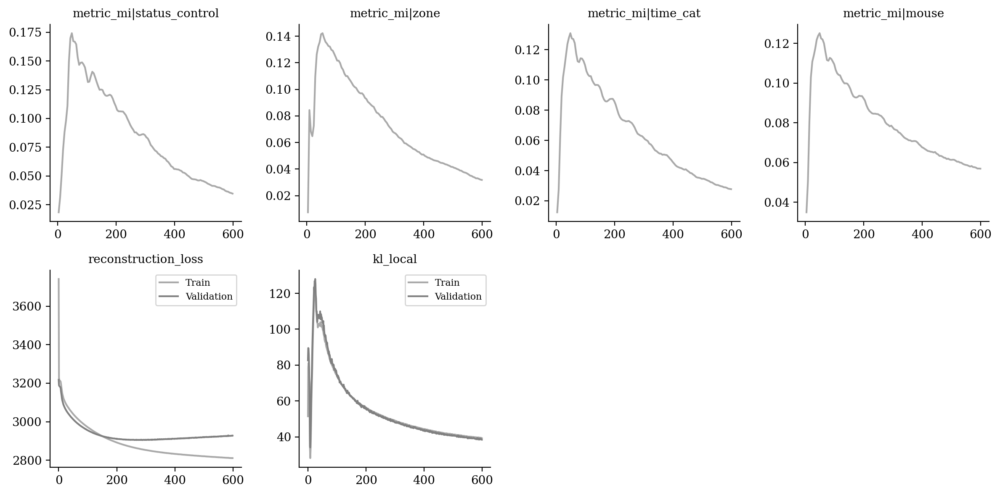

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

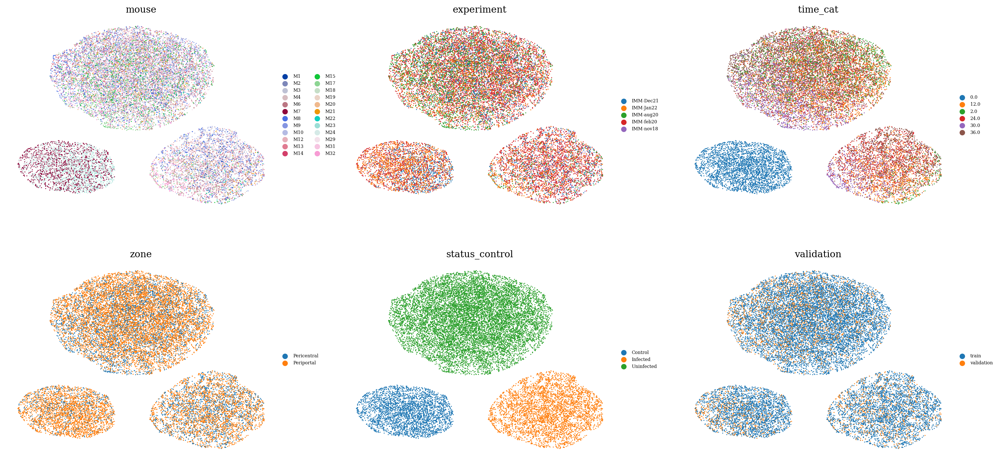

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

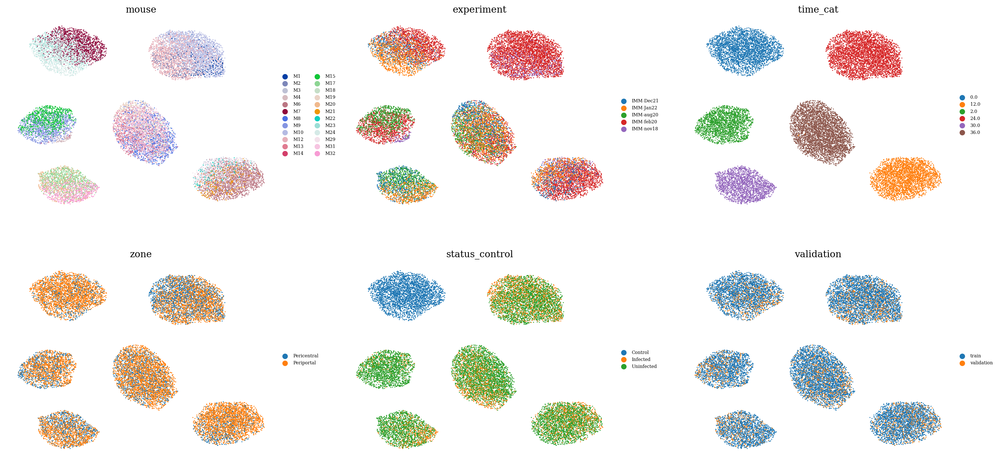

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

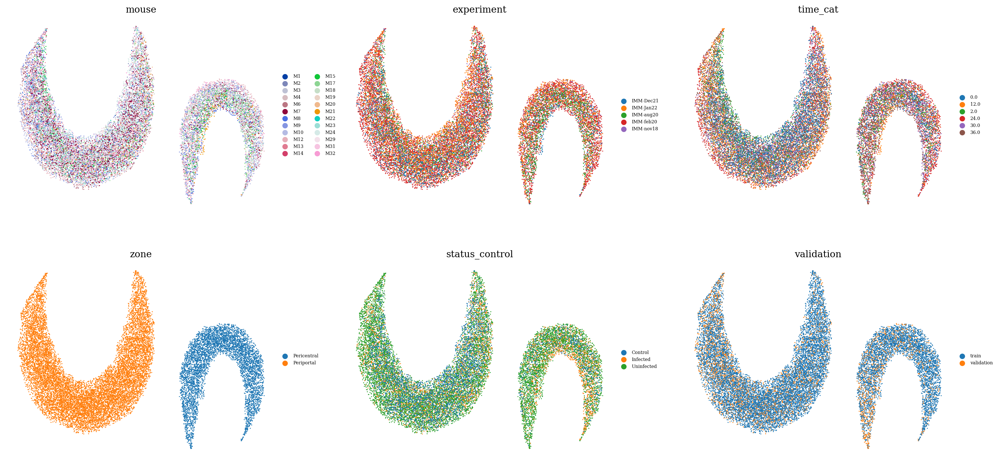

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

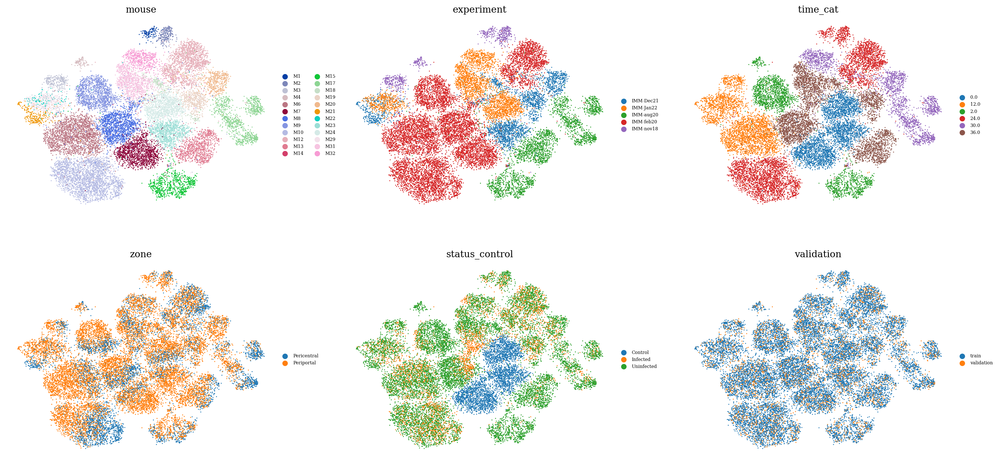

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

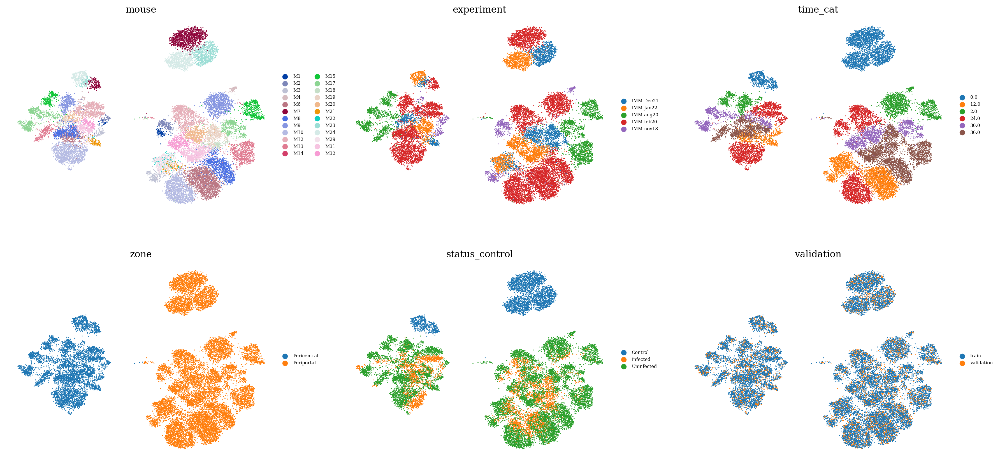

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

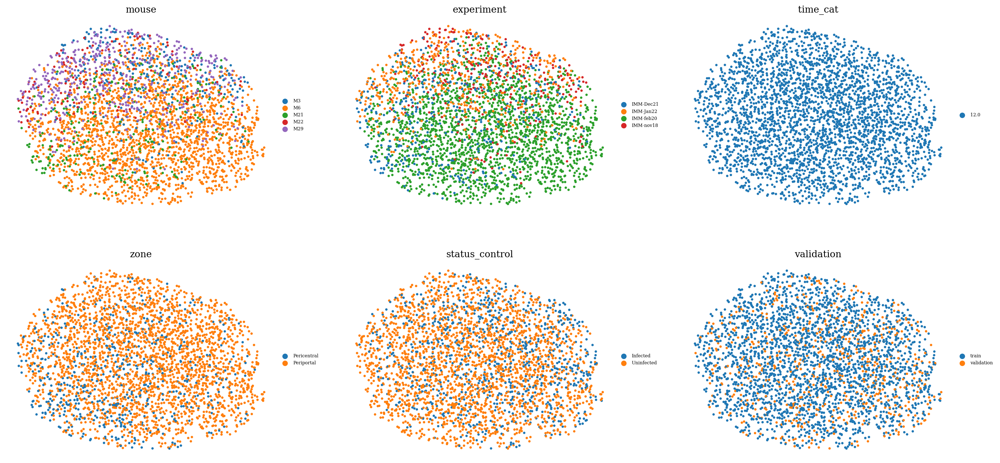

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )